In [2]:
import tensorflow as tf
import numpy as np
from itertools import cycle
import rasterio
from rasterio.plot import reshape_as_raster, reshape_as_image

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score

from keras.models import Sequential
from keras.layers import Dense, Conv2D, MaxPooling2D, BatchNormalization, Flatten, Dropout, InputLayer, MaxPool2D
from tensorflow.keras import optimizers, models
from keras.applications.resnet50 import ResNet50
from keras.models import Model
from keras.models import Sequential
from keras import optimizers
import keras

from deepforest import deepforest
from deepforest import get_data
from deepforest import utilities
from deepforest import preprocess

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical


/anaconda3/envs/venv/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/anaconda3/envs/venv/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/anaconda3/envs/venv/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/anaconda3/envs/venv/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:5

In [3]:
import skimage.color
import skimage.io

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os
import cv2

import torch
import torchvision.models as models
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torch.nn as nn
torch.manual_seed

<function torch.random.manual_seed(seed)>

In [4]:
import sys
package = os.path.dirname(os.getcwd())
sys.path.append(package)
sys.path.append(package + '/utils')
sys.path
from utils.deepforest_detection import *

In [4]:
def get_patches(path_to_img, boxes):
    # read image, based on command line filename argument;
    # read the image as grayscale from the outset
    patches = []

    image = skimage.io.imread(path_to_img)

    for index, row in boxes.iterrows():
        tree = image[int(row.ymin):int(row.ymax), int(row.xmin):int(row.xmax)]
        #plt.imshow(tree_gray, cmap=plt.get_cmap('gray'), vmin=0, vmax=1)
        #print('tree.shape',tree.shape)
        patches.append(tree.astype(object))
    #print('patches shape',len(patches))
    #patches = np.array(patches).astype(object)
    #print('patches shape',patches.shape)
    return(patches)

In [104]:
def clear(mydir):
    for f in os.listdir(mydir):
        os.remove(os.path.join(mydir, f))

def resize_patches(patches, mydir = None, name = None, save = False):
    n = len(patches)
    print(n)
    resized_patches = []
    for i in range(n):
        resized_patch = cv2.resize(np.array(patches[i], dtype = np.float32), (200, 200))
        if save == True:
            clear(mydir)
            path_save = mydir+"/patch_{}_{}.png".format(name, i)
            plt.imsave(path_save, resized_patch)
        resized_patches.append(resized_patch)
    return(np.array(resized_patches))

# Ecuador

## CNN on Handlabeled

In [109]:
# Choose an image where there are only Musacea trees (look like a Palm).
current_dir = os.getcwd()
path_to_img_pos = os.path.join(current_dir, 'images/Flora Pluas RGB/Flora Pluas RGB_6_3800_3800_7800_7800.png')
path_to_img_neg = os.path.join(current_dir, 'images/Manuel Macias RGB/Manuel Macias RGB_3_3800_0_7800_4000.png')
path_to_img_neg_2 = os.path.join(current_dir, 'images/Manuel Macias RGB/Manuel Macias RGB_9_9748_0_13748_4000.png')
path_to_img_neg_3 = os.path.join(current_dir, 'images/Manuel Macias RGB/Manuel Macias RGB_0_0_0_4000_4000.png')


In [110]:
test_model = deepforest.deepforest(saved_model = os.getcwd()+'/deepforest/final_model_4000_epochs_35.h5')

Reading config file: /anaconda3/envs/venv/lib/python3.6/site-packages/deepforest/data/deepforest_config.yml
Loading saved model
tracking <tf.Variable 'Variable_10:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_11:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_12:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_13:0' shape=(9, 4) dtype=float32> anchors
tracking <tf.Variable 'Variable_14:0' shape=(9, 4) dtype=float32> anchors


In [111]:
# Detect trees and extract patches (image of the canopy for each tree)
boxes_pos = get_annotations(path_to_img_pos, test_model)
patches_pos = get_patches(path_to_img_pos, boxes_pos)    

boxes_neg = get_annotations(path_to_img_neg, test_model)
patches_neg = get_patches(path_to_img_neg, boxes_neg)

boxes_neg_2 = get_annotations(path_to_img_neg_2, test_model)
patches_neg_2 = get_patches(path_to_img_neg_2, boxes_neg_2) 
                               
boxes_neg_3 = get_annotations(path_to_img_neg_3, test_model)
patches_neg_3 = get_patches(path_to_img_neg_3, boxes_neg_3) 

patches_neg = np.concatenate((patches_neg, patches_neg_2, patches_neg_3), axis=0)

<string>:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


In [112]:
n_pos = len(patches_pos)
n_neg = len(patches_neg)
n_pos, n_neg

(163, 237)

In [113]:
# Directory with our training dandelion pictures
musacea_dir = os.path.join('cnn/train_hand/musacea')

# Directory with our training grass pictures
other_dir = os.path.join('cnn/train_hand/other')

In [115]:
patches_pos = resize_patches(np.array(patches_pos), musacea_dir, name = 'pos', save = False)
patches_neg = resize_patches(np.array(patches_neg), other_dir, name = 'neg', save = False)

np.save('cnn/train_hand/patches_pos.npy', patches_pos)
np.save('cnn/train_hand/patches_neg.npy', patches_neg)

In [51]:
y_pos = np.array([0]*n_pos)
y_neg = np.array([1]*n_neg)

X = np.concatenate((patches_pos, patches_neg), axis=0)
y = np.concatenate((y_pos, y_neg), axis=0)

randomize = np.arange(len(X))
np.random.shuffle(randomize)
X = X[randomize]
y = y[randomize]

print(X.shape)
print(y.shape)

(400, 200, 200, 3)
(400,)


In [53]:
from sklearn.model_selection import train_test_split
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size = 0.20, random_state = 2)

In [55]:
#CNN model

from tensorflow.keras.preprocessing.image import ImageDataGenerator

# All images will be rescaled by 1./255
train_musacea = ImageDataGenerator(rescale=1/255)
validation_musacea = ImageDataGenerator(rescale=1/255)

# Flow training images in batches of 120 using train_datagen generator
train_generator = train_musacea.flow( X_train, y_train, # All images will be resized to 200x200
        batch_size=256)

# Flow validation images in batches of 19 using valid_datagen generator
validation_generator = validation_musacea.flow(X_val, y_val,  # All images will be resized to 200x200
        batch_size=60,
        shuffle=False)

In [56]:
IMG_SIZE = 200


model = Sequential()
model.add(Conv2D(64, kernel_size=6, activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, 3)))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization(momentum=0.01))

model.add(Conv2D(64, kernel_size=3, activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization(momentum=0.01))

model.add(Conv2D(32, kernel_size=3, activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization(momentum=0.01))

model.add(Conv2D(32, kernel_size=3, activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization(momentum=0.01))

model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(1, activation='sigmoid'))


In [57]:
model.compile(optimizer = 'rmsprop',
              loss = 'binary_crossentropy',
              metrics=['accuracy'])

In [58]:
history = model.fit(train_generator,  
      epochs=3,
      verbose=1,
      validation_data = validation_generator)

Epoch 1/3
2/2 [==============================] - 52s 26s/step - loss: 1.4119 - accuracy: 0.5656 - val_loss: 8.3144 - val_accuracy: 0.6375
Epoch 2/3
2/2 [==============================] - 47s 23s/step - loss: 1.1531 - accuracy: 0.6844 - val_loss: 1.8988 - val_accuracy: 0.6250
Epoch 3/3
2/2 [==============================] - 47s 24s/step - loss: 0.5830 - accuracy: 0.8750 - val_loss: 0.2402 - val_accuracy: 0.9125


In [61]:
model.evaluate(validation_generator)

2/2 [==============================] - 2s 1s/step


[0.24021759629249573, 0.9125000238418579]

[[0.09790328]
 [0.63366395]
 [0.45319727]
 [0.14227483]
 [0.15735444]
 [0.73943913]
 [0.03955323]
 [0.12618035]
 [0.20168144]
 [0.33685338]
 [0.5012636 ]
 [0.32374   ]
 [0.16391152]
 [0.21808496]
 [0.31388015]
 [0.00564894]
 [0.317532  ]
 [0.01546872]
 [0.8643086 ]
 [0.0251298 ]
 [0.06698895]
 [0.1838117 ]
 [0.38025352]
 [0.24067861]
 [0.06313851]
 [0.00745293]
 [0.01647925]
 [0.37539193]
 [0.04562959]
 [0.01349139]
 [0.0370397 ]
 [0.11973706]
 [0.03276673]
 [0.01271144]
 [0.08961743]
 [0.03114691]
 [0.03341028]
 [0.18866876]
 [0.24467337]
 [0.00203475]
 [0.11221445]
 [0.06978771]
 [0.09416947]
 [0.00981328]
 [0.20313409]
 [0.48336688]
 [0.16328171]
 [0.01610321]
 [0.06624752]
 [0.05997241]
 [0.13128027]
 [0.08806106]
 [0.18497187]
 [0.7998537 ]
 [0.43571633]
 [0.20100403]
 [0.15136713]
 [0.03023562]
 [0.18800914]
 [0.0369426 ]
 [0.01658669]
 [0.24399644]
 [0.01745066]
 [0.0021663 ]
 [0.04835096]
 [0.06601584]
 [0.08009592]
 [0.00566089]
 [0.26988328]
 [0.12964186]
 [0.07092783]
 [0.01

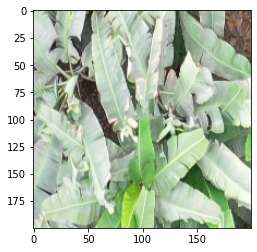

label is:  0
class is:  [0.09790328]


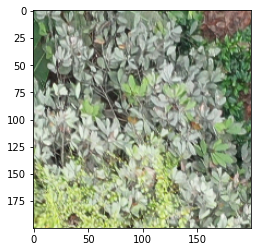

label is:  1
class is:  [0.63366395]


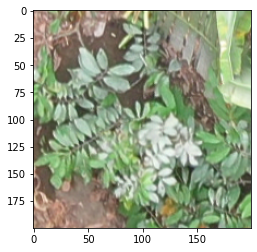

label is:  1
class is:  [0.45319727]


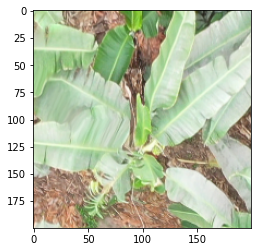

label is:  0
class is:  [0.14227483]


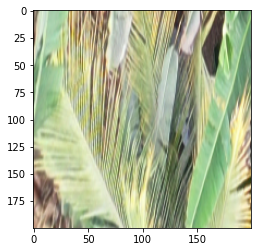

label is:  1
class is:  [0.15735444]


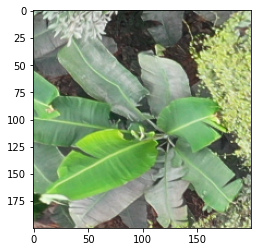

label is:  0
class is:  [0.73943913]


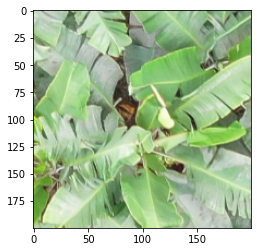

label is:  0
class is:  [0.03955323]


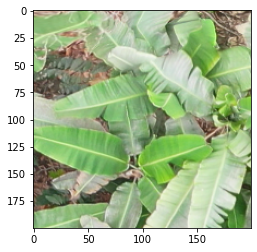

label is:  0
class is:  [0.12618035]


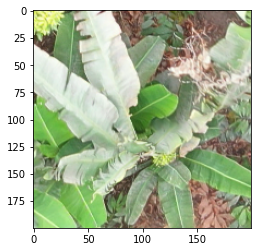

label is:  0
class is:  [0.20168144]


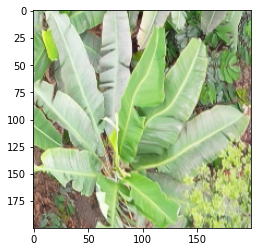

label is:  0
class is:  [0.33685338]


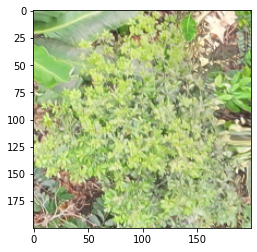

label is:  1
class is:  [0.5012636]


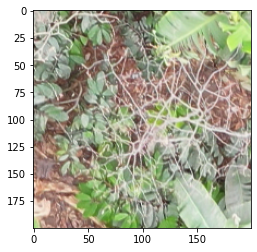

label is:  1
class is:  [0.32374]


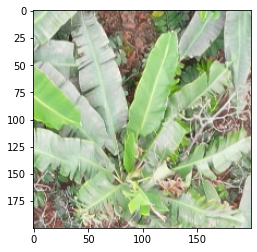

label is:  0
class is:  [0.16391152]


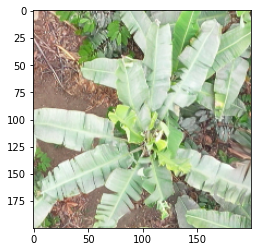

label is:  0
class is:  [0.21808496]


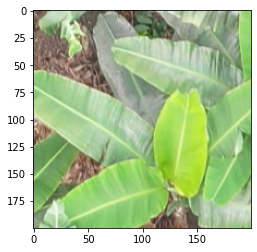

label is:  0
class is:  [0.31388015]


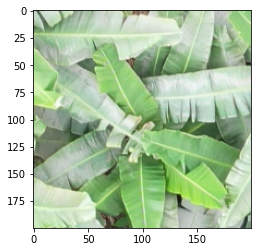

label is:  0
class is:  [0.00564894]


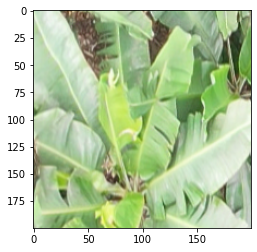

label is:  0
class is:  [0.317532]


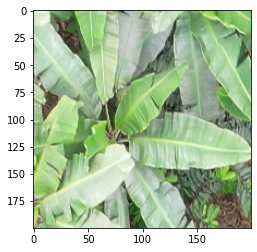

label is:  0
class is:  [0.01546872]


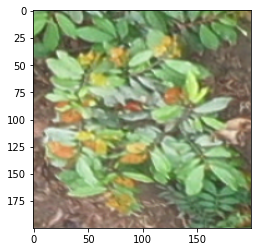

label is:  1
class is:  [0.8643086]


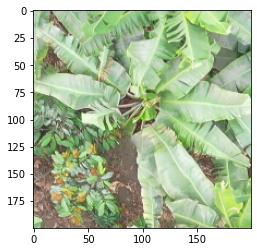

label is:  0
class is:  [0.0251298]


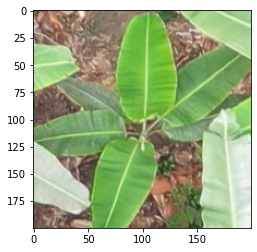

label is:  0
class is:  [0.06698895]


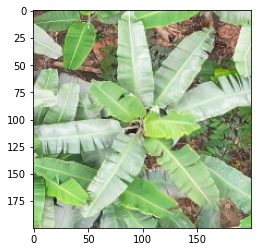

label is:  0
class is:  [0.1838117]


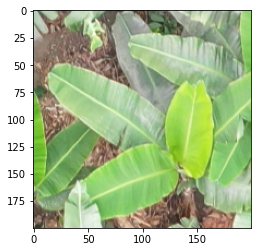

label is:  0
class is:  [0.38025352]


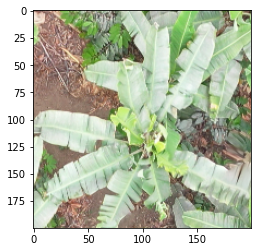

label is:  0
class is:  [0.24067861]


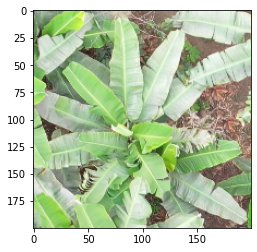

label is:  0
class is:  [0.06313851]


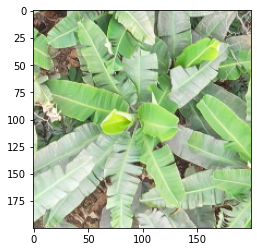

label is:  0
class is:  [0.00745293]


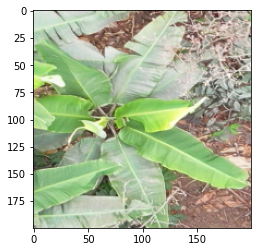

label is:  0
class is:  [0.01647925]


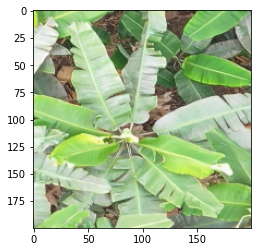

label is:  0
class is:  [0.37539193]


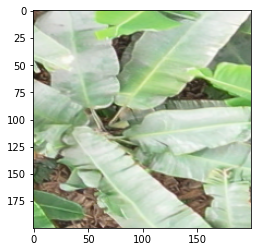

label is:  0
class is:  [0.04562959]


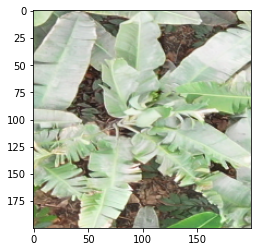

label is:  0
class is:  [0.01349139]


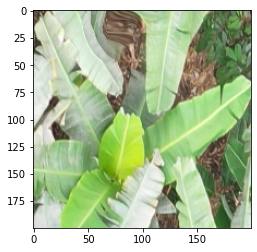

label is:  0
class is:  [0.0370397]


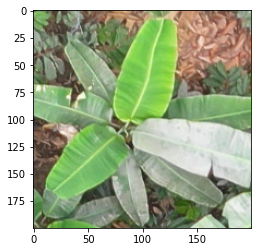

label is:  0
class is:  [0.11973706]


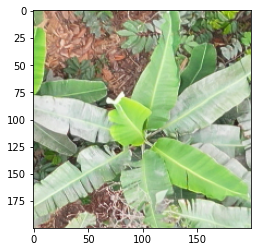

label is:  0
class is:  [0.03276673]


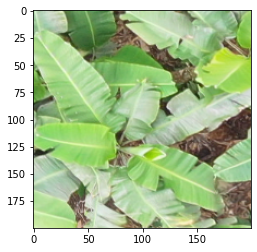

label is:  0
class is:  [0.01271144]


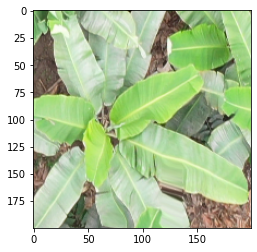

label is:  0
class is:  [0.08961743]


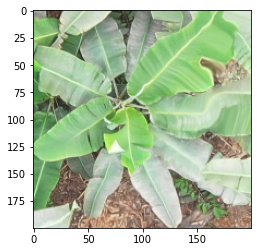

label is:  0
class is:  [0.03114691]


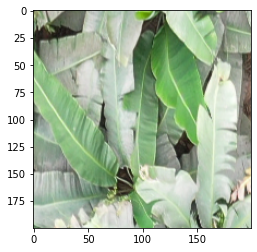

label is:  0
class is:  [0.03341028]


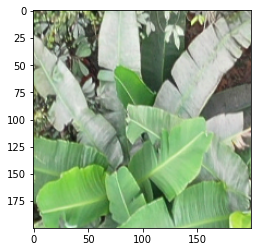

label is:  0
class is:  [0.18866876]


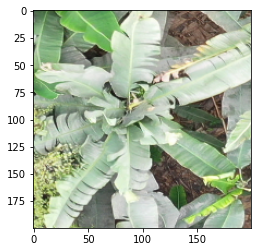

label is:  0
class is:  [0.24467337]


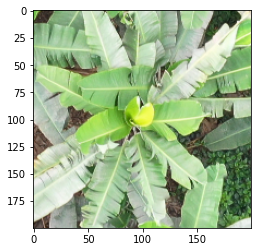

label is:  0
class is:  [0.00203475]


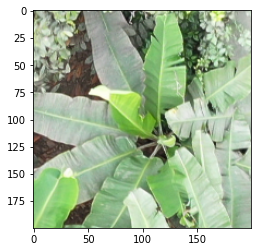

label is:  0
class is:  [0.11221445]


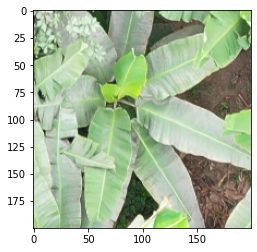

label is:  0
class is:  [0.06978771]


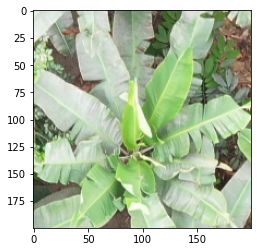

label is:  0
class is:  [0.09416947]


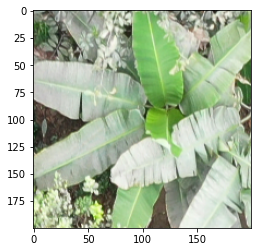

label is:  0
class is:  [0.00981328]


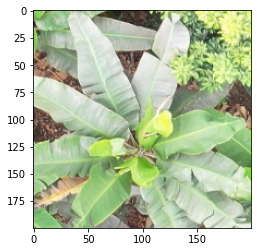

label is:  0
class is:  [0.20313409]


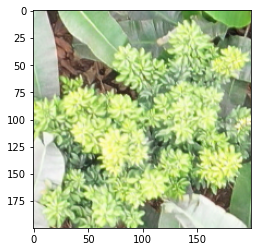

label is:  1
class is:  [0.48336688]


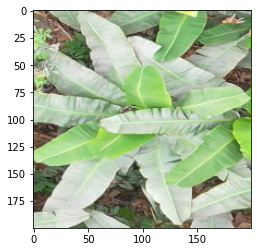

label is:  0
class is:  [0.16328171]


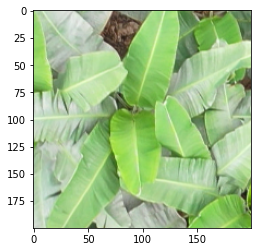

label is:  0
class is:  [0.01610321]


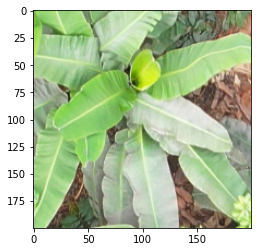

label is:  0
class is:  [0.06624752]


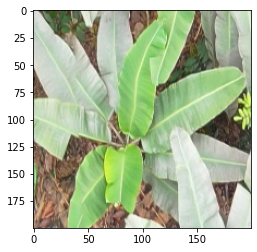

label is:  0
class is:  [0.05997241]


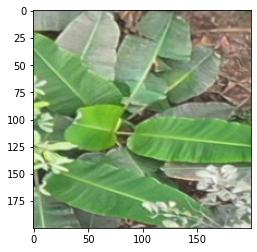

label is:  0
class is:  [0.13128027]


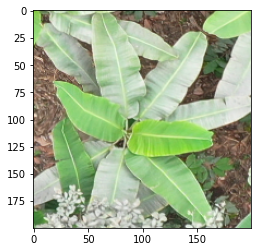

label is:  0
class is:  [0.08806106]


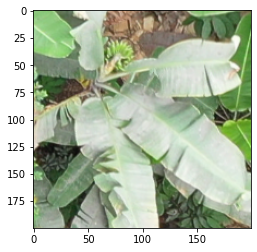

label is:  0
class is:  [0.18497187]


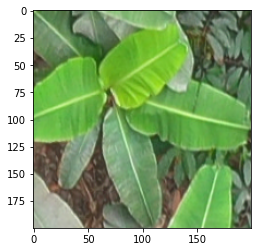

label is:  0
class is:  [0.7998537]


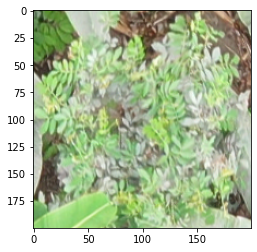

label is:  1
class is:  [0.43571633]


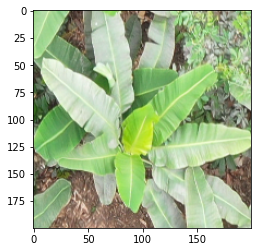

label is:  0
class is:  [0.20100403]


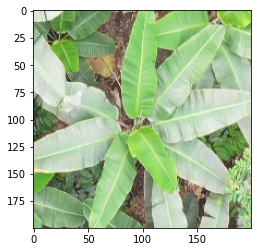

label is:  0
class is:  [0.15136713]


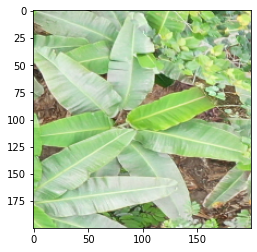

label is:  0
class is:  [0.03023562]


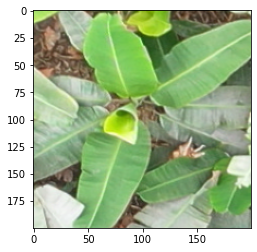

label is:  0
class is:  [0.18800914]


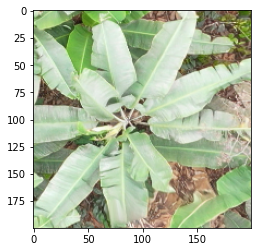

label is:  0
class is:  [0.0369426]


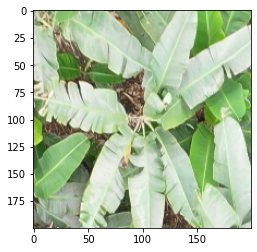

label is:  0
class is:  [0.01658669]


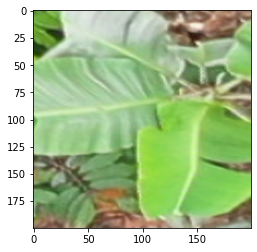

label is:  0
class is:  [0.24399644]


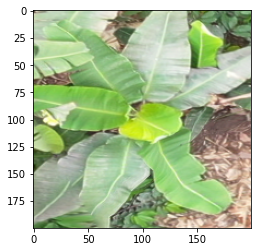

label is:  0
class is:  [0.01745066]


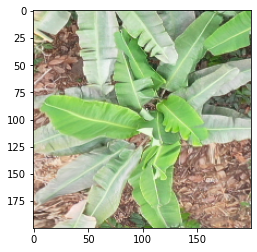

label is:  0
class is:  [0.0021663]


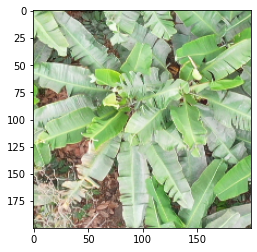

label is:  0
class is:  [0.04835096]


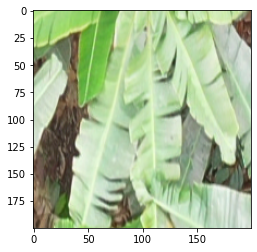

label is:  0
class is:  [0.06601584]


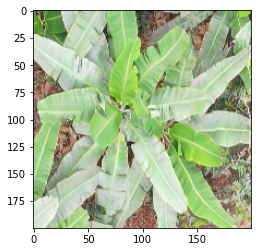

label is:  0
class is:  [0.08009592]


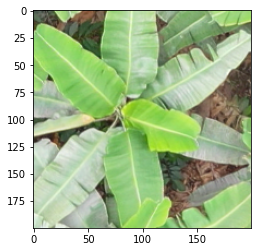

label is:  0
class is:  [0.00566089]


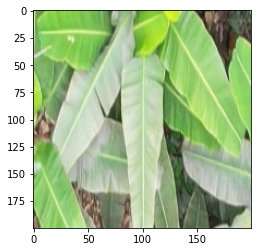

label is:  0
class is:  [0.26988328]


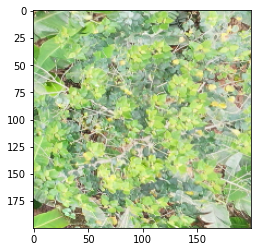

label is:  1
class is:  [0.12964186]


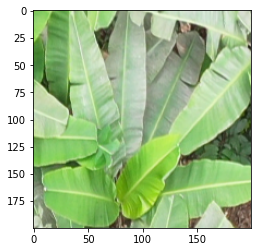

label is:  0
class is:  [0.07092783]


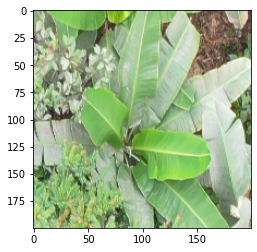

label is:  0
class is:  [0.01496154]


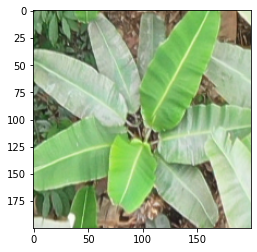

label is:  0
class is:  [0.26538563]


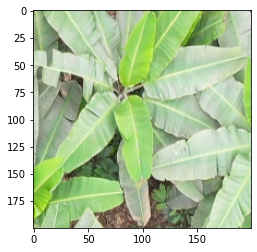

label is:  0
class is:  [0.03810164]


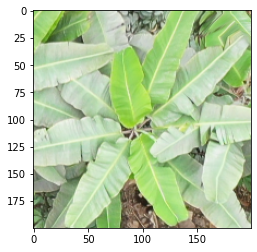

label is:  0
class is:  [0.06496462]


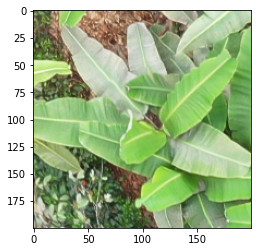

label is:  0
class is:  [0.33749527]


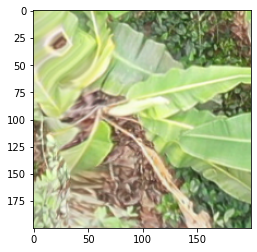

label is:  0
class is:  [0.28400964]


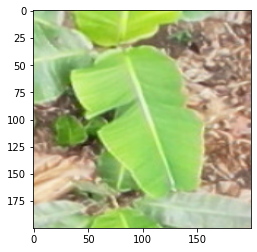

label is:  0
class is:  [0.03118643]


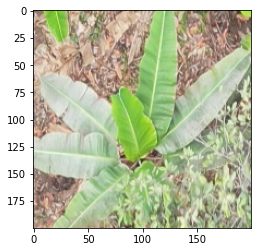

label is:  0
class is:  [0.14394712]


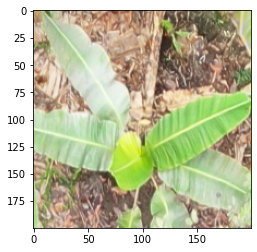

label is:  0
class is:  [0.4410181]


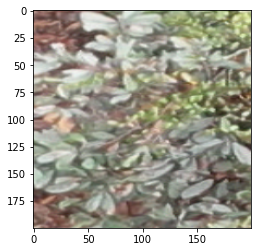

label is:  1
class is:  [0.29472548]


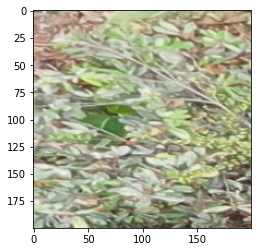

label is:  1
class is:  [0.1455706]


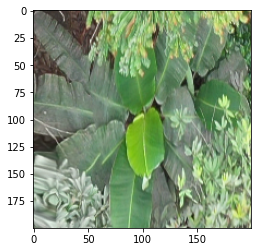

label is:  0
class is:  [0.7499135]


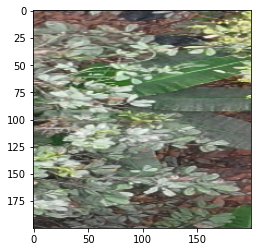

label is:  1
class is:  [0.89658076]


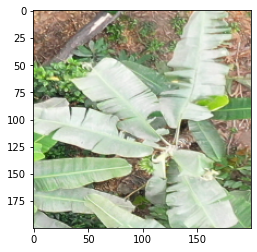

label is:  0
class is:  [0.21811]


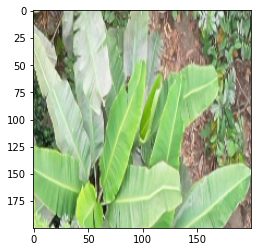

label is:  0
class is:  [0.02726558]


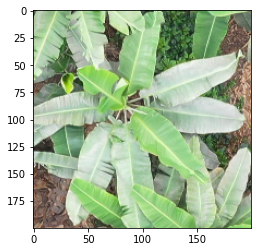

label is:  0
class is:  [0.07667848]


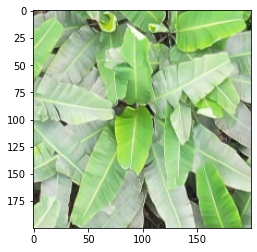

label is:  0
class is:  [0.34886032]


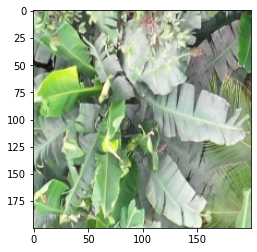

label is:  0
class is:  [0.12182334]


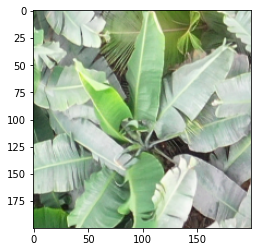

label is:  0
class is:  [0.00765857]


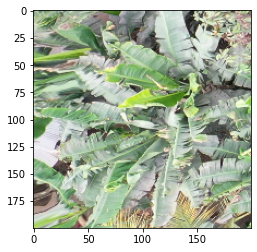

label is:  0
class is:  [0.18268514]


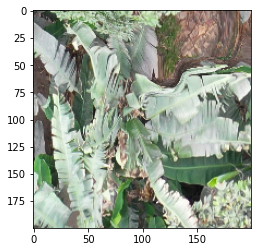

label is:  0
class is:  [0.1261105]


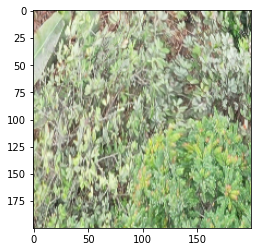

label is:  1
class is:  [0.42152026]


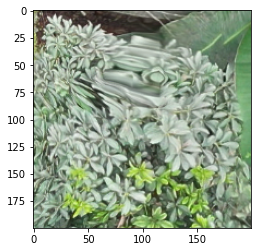

label is:  1
class is:  [0.99895763]


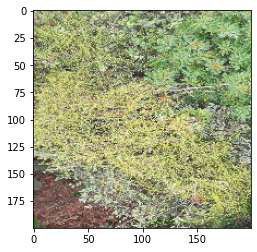

label is:  1
class is:  [0.9687421]


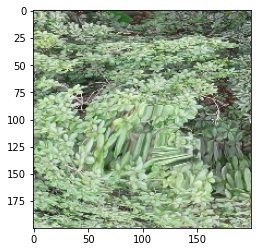

label is:  1
class is:  [0.99999976]


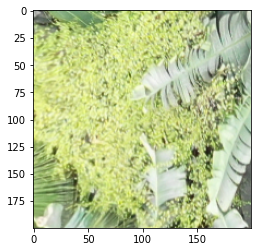

label is:  1
class is:  [0.47169012]


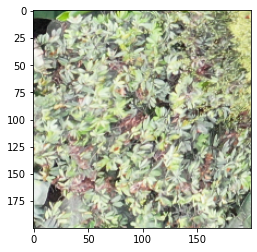

label is:  1
class is:  [0.50711095]


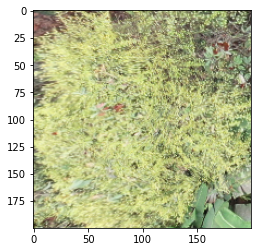

label is:  1
class is:  [0.43348294]


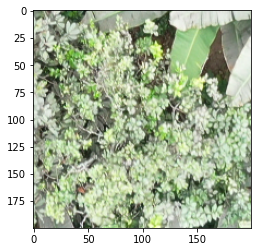

label is:  1
class is:  [0.9982364]


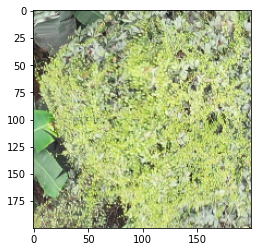

label is:  1
class is:  [0.19472253]


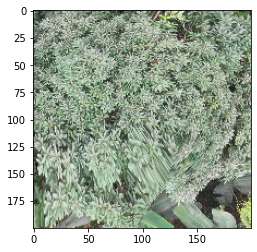

label is:  1
class is:  [0.999995]


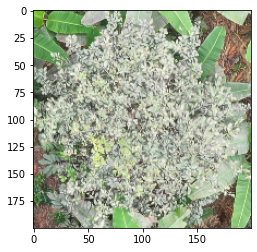

label is:  1
class is:  [0.6631372]


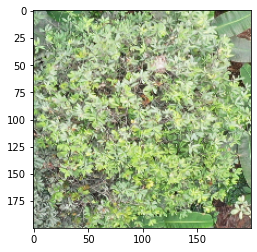

label is:  1
class is:  [0.9957036]


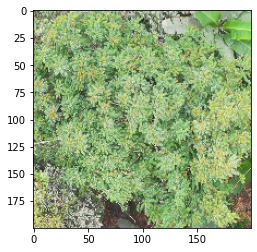

label is:  1
class is:  [0.9999341]
Accuracy for CNN model trained on 400 Handlabeled patches, tested on 105 Handlabeled patches:  0.8571428571428571


In [67]:
X_test = np.load('cnn/test/patches.npy')
y_true = np.load('cnn/test/labels.npy')
y_true = y_true.astype(int)

classes = model.predict(X_test/255)
print(classes)

for i in range(len(X_test)):
    plt.imshow(X_test[i])
    plt.show()
    print('label is: ', y_true[i])
    print('class is: ', classes[i])
    
y_pred = classes.round()

print('Accuracy for CNN model trained on 400 Handlabeled patches, tested on 105 Handlabeled patches: ', accuracy_score(y_true, y_pred))

In [132]:
model.save('cnn/model')

## CNN on Matches

In [123]:
final = pd.read_csv('Ecuador/results/Gromov-Wasserstein Greedy_final_matching.csv', index_col = 0)

In [124]:
final_pos = final[final['is_musacea_g'] == 0]
final_neg = final[final['is_musacea_g'] == 1]

In [125]:
def get_patches(path_to_img, boxes):
    # read image, based on command line filename argument;
    # read the image as grayscale from the outset
    patches = []

    image = skimage.io.imread(path_to_img)

    for index, row in boxes.iterrows():
        tree = image[int(row.ymin):int(row.ymax), int(row.xmin):int(row.xmax)]
        if tree.shape == (201,312,3):
            continue
        patches.append(tree)
    return(patches)

def patch_match(final):
    list_tiles = np.unique(final['img_path'])
    patches = []
    for path in list_tiles:
        sub = final[final.img_path == path]
        site = path.split('_')[0]
        path_to_img = os.path.join(os.getcwd(), 'Ecuador/images/{}/{}'.format(site, path))
        boxes = sub[['xmin', 'ymin', 'xmax', 'ymax']]
        patch = get_patches(path_to_img, boxes)
        b = np.array(patch)
        if b.shape[0] == 1 | len(b.shape)==3:
            continue
        patches.extend(patch)
    return(np.array(patches))

In [126]:
patches_pos = patch_match(final_pos)
patches_neg = patch_match(final_neg)


/anaconda3/envs/venv/lib/python3.6/site-packages/ipykernel_launcher.py:24: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
/anaconda3/envs/venv/lib/python3.6/site-packages/ipykernel_launcher.py:28: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray


In [127]:
n_pos = len(patches_pos)
n_neg = len(patches_neg)
n_pos, n_neg

(1503, 3161)

In [128]:
patches_pos = resize_patches(np.array(patches_pos))
patches_neg = resize_patches(np.array(patches_neg))

np.save('Ecuador/cnn/train_gw/patches_pos.npy', patches_pos)
np.save('Ecuador/cnn/train_gw/patches_neg.npy', patches_neg)

1503
3161


In [82]:
y_pos = np.array([0]*n_pos)
y_neg = np.array([1]*n_neg)

X = np.concatenate((patches_pos, patches_neg), axis=0)
y = np.concatenate((y_pos, y_neg), axis=0)

randomize = np.arange(len(X))
np.random.shuffle(randomize)
X = X[randomize]
y = y[randomize]

print(X.shape)
print(y.shape)


(4665, 200, 200, 3)
(4665,)


In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size = 0.20, random_state = 2)

In [74]:
#CNN model

from tensorflow.keras.preprocessing.image import ImageDataGenerator

# All images will be rescaled by 1./255
train_musacea = ImageDataGenerator(rescale=1/255)
validation_musacea = ImageDataGenerator(rescale=1/255)

# Flow training images in batches of 120 using train_datagen generator
train_generator = train_musacea.flow( X_train, y_train,
        target_size=(200, 200),  # All images will be resized to 200x200
        batch_size=256)

# Flow validation images in batches of 19 using valid_datagen generator
validation_generator = validation_musacea.flow(X_val, y_val,
        target_size=(200, 200),  # All images will be resized to 200x200
        batch_size=60,
        shuffle=False)

Found 3917 images belonging to 2 classes.
Found 980 images belonging to 2 classes.


In [154]:
# build a sequential model
model_2 = Sequential()
model_2.add(InputLayer(input_shape=(200, 200, 3)))

# 1st conv block
model_2.add(Conv2D(25, (5, 5), activation='relu', strides=(1, 1), padding='same'))
model_2.add(MaxPool2D(pool_size=(2, 2), padding='same'))
# 2nd conv block
model_2.add(Conv2D(50, (5, 5), activation='relu', strides=(2, 2), padding='same'))
model_2.add(MaxPool2D(pool_size=(2, 2), padding='same'))
model_2.add(BatchNormalization())
# 3rd conv block
model_2.add(Conv2D(70, (3, 3), activation='relu', strides=(2, 2), padding='same'))
model_2.add(MaxPool2D(pool_size=(2, 2), padding='valid'))
model_2.add(BatchNormalization())
# ANN block
model_2.add(Flatten())
model_2.add(Dense(units=100, activation='relu'))
model_2.add(Dense(units=100, activation='relu'))
model_2.add(Dropout(0.25))
# output layer
model_2.add(Dense(units=1, activation='sigmoid'))


# compile model
#opt = tf.keras.optimizers.SGD(lr=0.01)
#opt = tf.keras.optimizers.Adam(learning_rate=0.1)

#opt = tf.keras.optimizers.RMSprop(lr=0.01)

model_2.compile(optimizer='rmsprop', loss = 'binary_crossentropy', metrics = ['accuracy'])

# fit on data for 30 epochs
history = model_2.fit(train_generator,  
      epochs=5,
      verbose=1,
      validation_data = validation_generator)
      #use_multiprocessing=True, workers=8)



Epoch 1/5
17/17 [==============================] - 161s 9s/step - loss: 0.4416 - accuracy: 0.8024 - val_loss: 2.7668 - val_accuracy: 0.3324
Epoch 2/5
17/17 [==============================] - 134s 8s/step - loss: 0.2185 - accuracy: 0.9087 - val_loss: 3.3601 - val_accuracy: 0.3324
Epoch 3/5
17/17 [==============================] - 158s 9s/step - loss: 0.1360 - accuracy: 0.9443 - val_loss: 4.1694 - val_accuracy: 0.3324
Epoch 4/5
17/17 [==============================] - 169s 10s/step - loss: 0.1239 - accuracy: 0.9511 - val_loss: 3.6514 - val_accuracy: 0.3365
Epoch 5/5
17/17 [==============================] - 139s 8s/step - loss: 0.0695 - accuracy: 0.9735 - val_loss: 3.2638 - val_accuracy: 0.3539


In [77]:
model_2.evaluate(validation_generator)

17/17 [==============================] - 7s 435ms/step


[0.7830033302307129, 0.6653061509132385]

10/10 [==============================] - 15s 2s/step


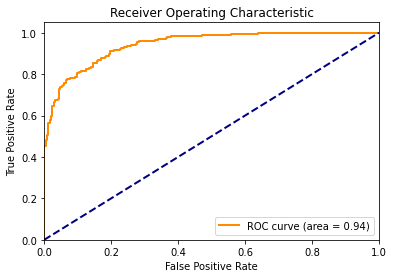

In [155]:
STEP_SIZE_TEST=validation_generator.n//validation_generator.batch_size
validation_generator.reset()
preds = model_2.predict(validation_generator,
                      verbose=1)

fpr, tpr, _ = roc_curve(validation_generator.classes, preds)
roc_auc = auc(fpr, tpr)

plt.figure()
lw = 2
plt.plot(fpr, tpr, color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()

In [214]:
model_2.save('cnn/model_nn_hand')

## Compare models

In [215]:
model_1 = models.load_model('cnn/model_hand')
model_2 = models.load_model('cnn/model_nn_hand')

In [116]:
def convert_xml_to_csv(directory, name, train_on_resized = True):
    xml = get_data(os.path.join(os.getcwd(), directory,"{}.xml".format(name)))
    hand_annotations = utilities.xml_to_annotations(xml)
    hand_annotations.to_csv(os.path.join(os.getcwd(), directory,"hand_{}.csv".format(name)),index=False, header=None)
    if train_on_resized == True:
        hand_annotations = resize_annotations(hand_annotations)
    return hand_annotations

In [117]:
def get_patches_and_labels(directory, name, path_to_img, boxes):
    # read image, based on command line filename argument;
    # read the image as grayscale from the outset
    patches = []
    labels = []
    image = skimage.io.imread(path_to_img)

    for index, row in boxes.iterrows():
        tree = image[int(row.ymin):int(row.ymax), int(row.xmin):int(row.xmax)]
        tree = cv2.resize(tree, (200, 200))
        plt.imshow(tree)
        plt.show()
        labels.append(input('Is it a Musacea? '))
        patches.append(tree)
        
    patches = np.array(patches)
    labels = np.array(labels)
    np.save('cnn/test2/labels.npy', labels)
    np.save('cnn/test2/patches.npy', patches)
    
    boxes_test['labels'] = labels
    boxes_test.to_csv(os.path.join(os.getcwd(), directory,"hand_{}.csv".format(name)),index=False, header=None)
    return(patches, labels)

In [118]:
boxes_test = convert_xml_to_csv('cnn/test2', 'test_example_2', train_on_resized = False)

In [119]:
boxes_test.columns

Index(['image_path', 'xmin', 'ymin', 'xmax', 'ymax', 'label'], dtype='object')

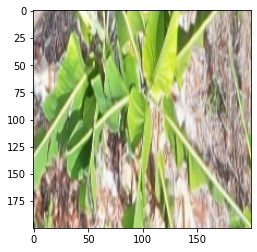

Is it a Musacea? 0


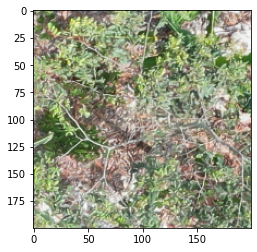

Is it a Musacea? 1


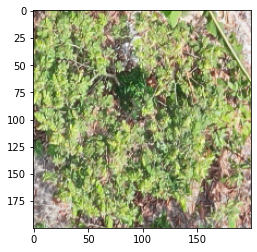

Is it a Musacea? 1


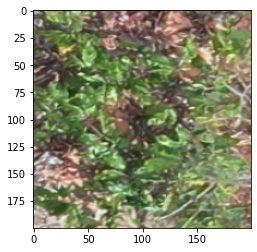

Is it a Musacea? 1


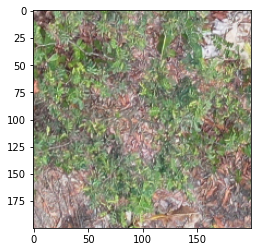

Is it a Musacea? 1


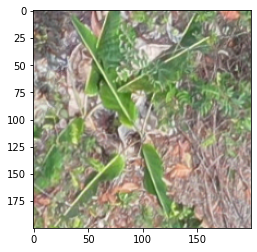

Is it a Musacea? 0


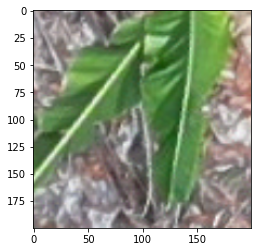

Is it a Musacea? 0


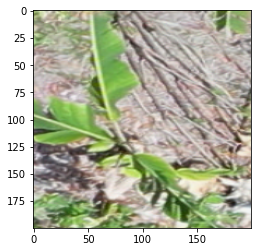

Is it a Musacea? 0


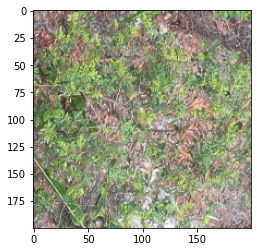

Is it a Musacea? 1


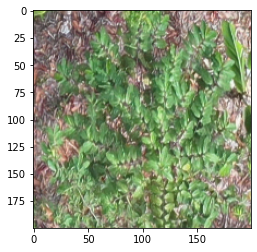

Is it a Musacea? 1


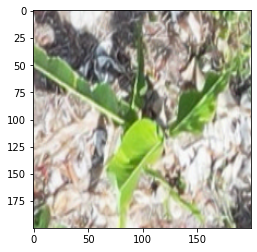

Is it a Musacea? 0


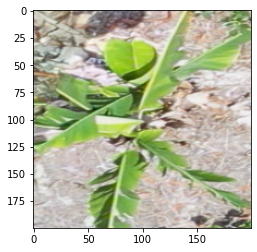

Is it a Musacea? 0


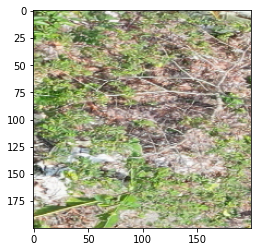

Is it a Musacea? 1


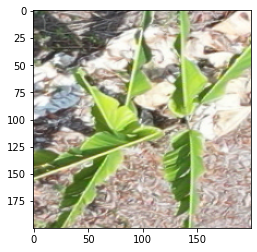

Is it a Musacea? 0


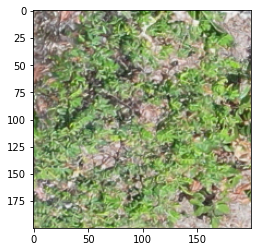

Is it a Musacea? 1


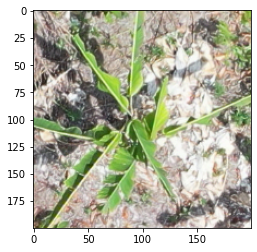

Is it a Musacea? 0


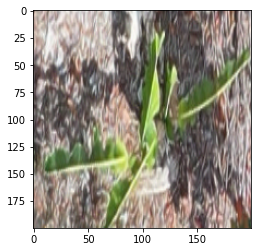

Is it a Musacea? 0


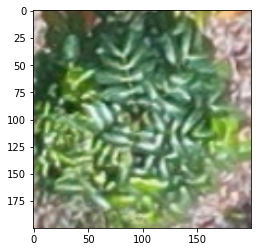

Is it a Musacea? 1


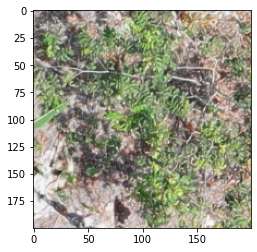

Is it a Musacea? 1


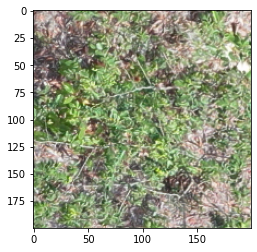

Is it a Musacea? 1


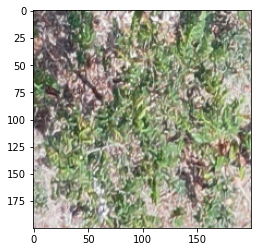

Is it a Musacea? 1


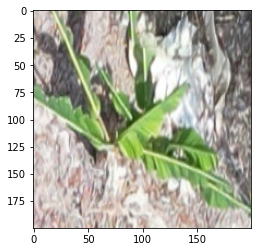

Is it a Musacea? 0


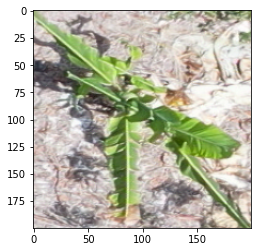

Is it a Musacea? 0


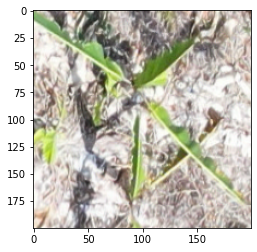

Is it a Musacea? 0


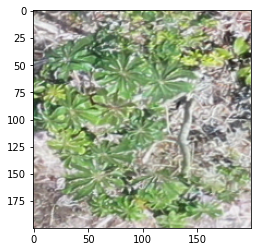

Is it a Musacea? 1


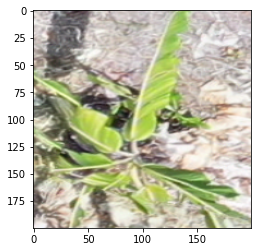

Is it a Musacea? 0


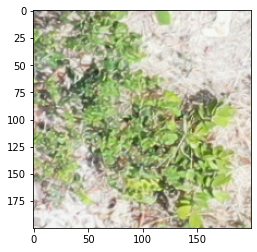

Is it a Musacea? 1


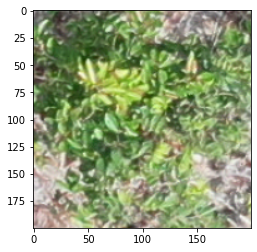

Is it a Musacea? 1


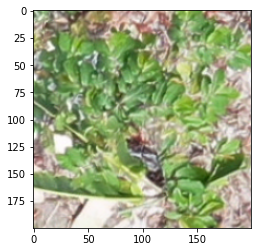

Is it a Musacea? 1


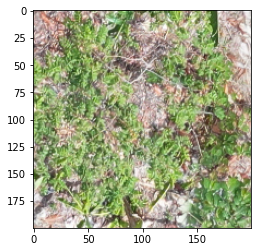

Is it a Musacea? 1


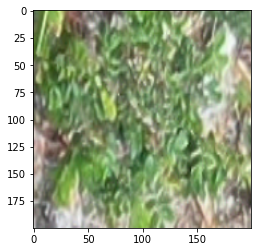

Is it a Musacea? 1


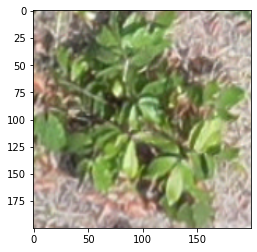

Is it a Musacea? 1


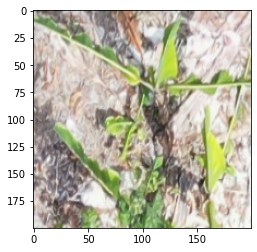

Is it a Musacea? 0


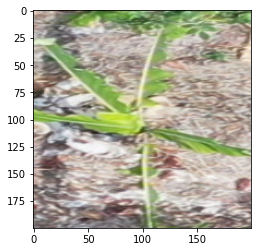

Is it a Musacea? 0


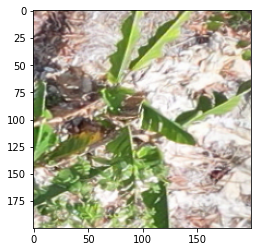

Is it a Musacea? 0


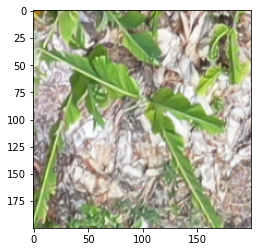

Is it a Musacea? 0


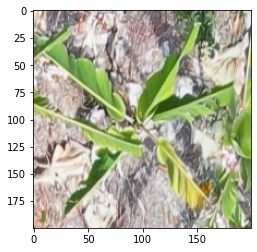

Is it a Musacea? 0


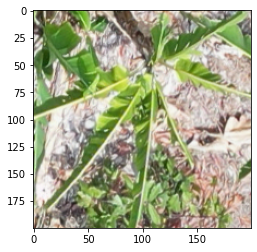

Is it a Musacea? 0


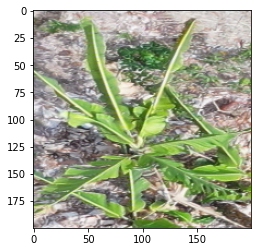

Is it a Musacea? 0


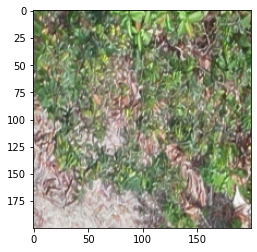

Is it a Musacea? 1


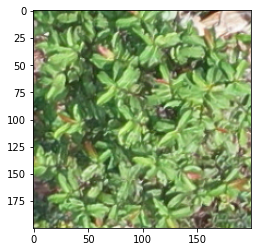

Is it a Musacea? 1


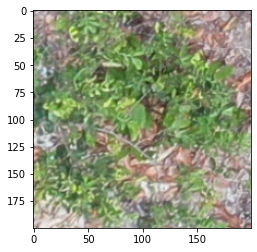

Is it a Musacea? 1


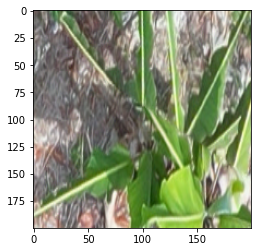

Is it a Musacea? 0


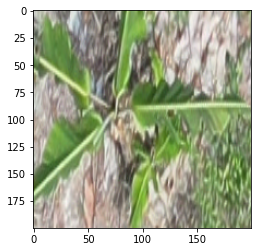

Is it a Musacea? 0


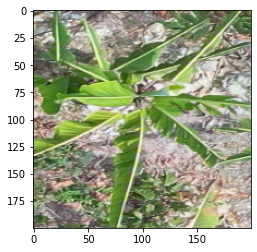

Is it a Musacea? 0


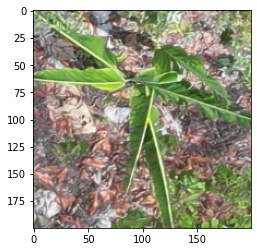

Is it a Musacea? 0


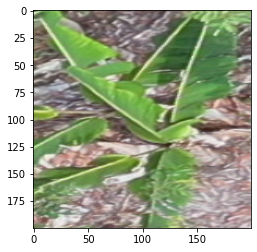

Is it a Musacea? 0


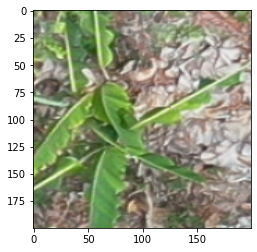

Is it a Musacea? 0


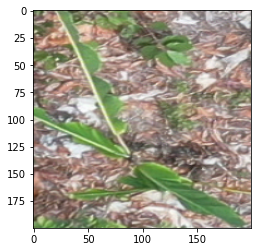

Is it a Musacea? 0


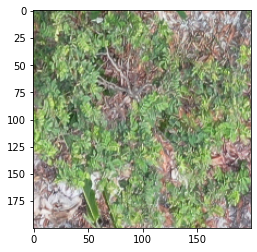

Is it a Musacea? 1


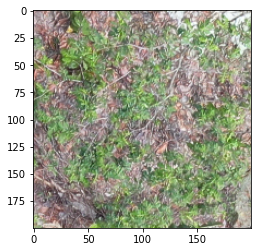

Is it a Musacea? 1


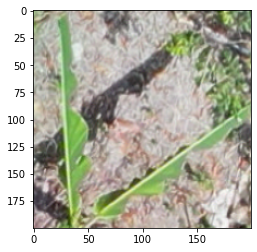

Is it a Musacea? 0


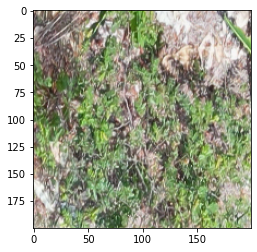

Is it a Musacea? 1


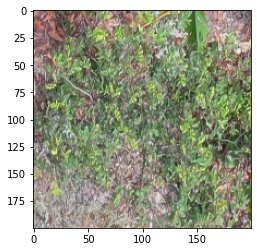

Is it a Musacea? 1


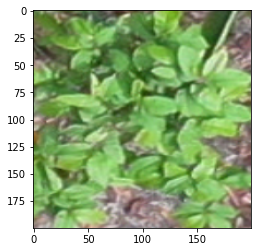

Is it a Musacea? 1


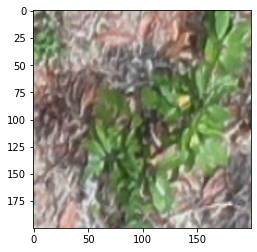

Is it a Musacea? 1


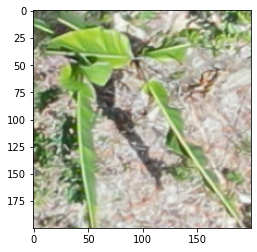

Is it a Musacea? 0


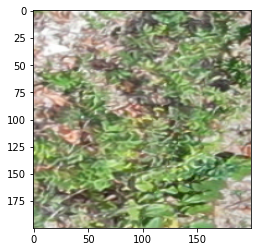

Is it a Musacea? 1


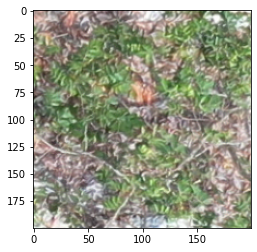

Is it a Musacea? 1


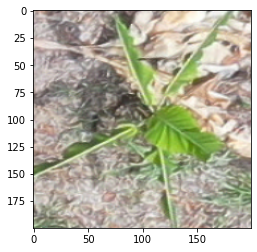

Is it a Musacea? 0


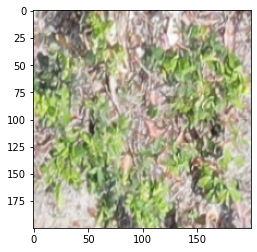

Is it a Musacea? 1


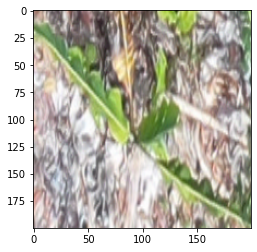

Is it a Musacea? 0


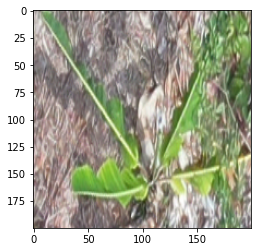

Is it a Musacea? 0


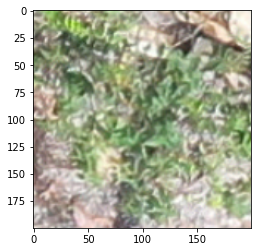

Is it a Musacea? 1


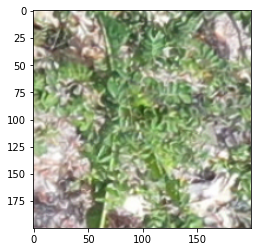

Is it a Musacea? 1


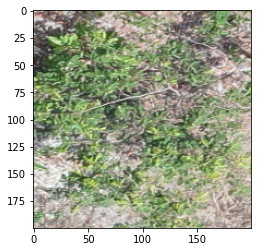

Is it a Musacea? 1


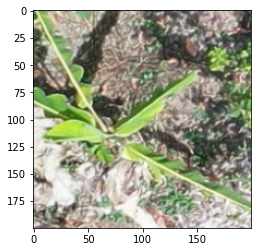

Is it a Musacea? 0


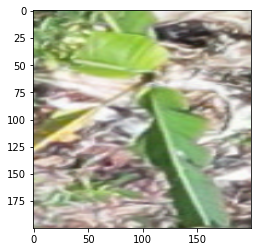

Is it a Musacea? 0


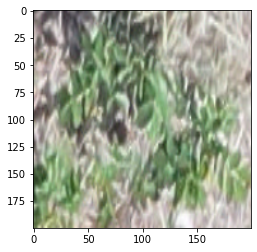

Is it a Musacea? 1


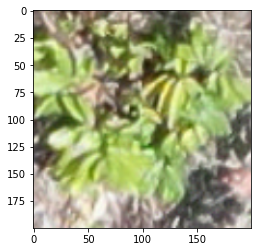

Is it a Musacea? 1


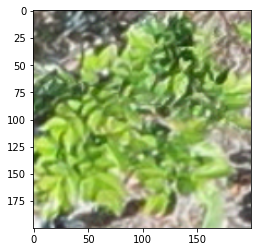

Is it a Musacea? 1


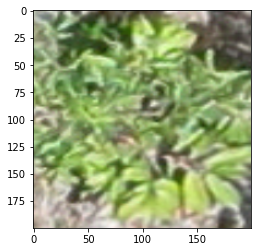

Is it a Musacea? 1


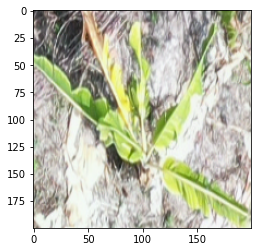

Is it a Musacea? 0


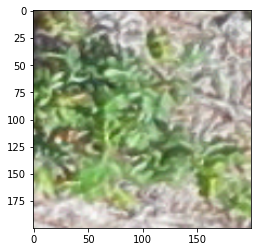

Is it a Musacea? 1


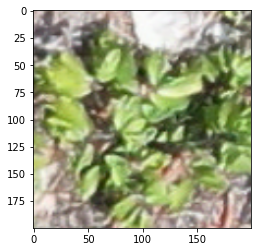

Is it a Musacea? 1


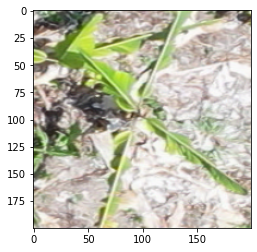

Is it a Musacea? 0


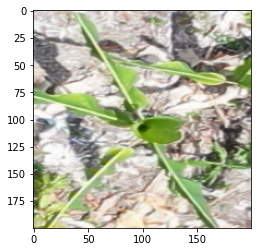

Is it a Musacea? 0


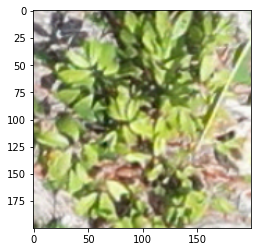

Is it a Musacea? 1


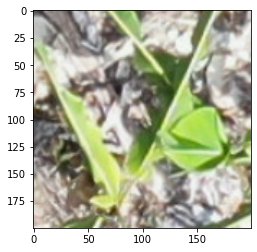

Is it a Musacea? 0


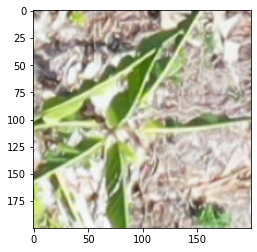

Is it a Musacea? 0


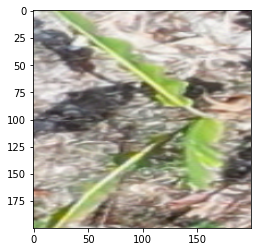

Is it a Musacea? 0


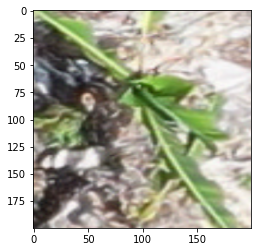

Is it a Musacea? 0


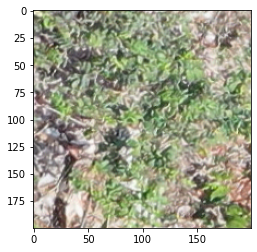

Is it a Musacea? 1


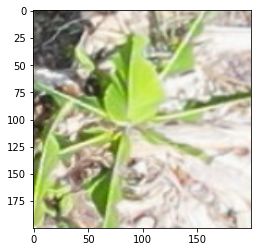

Is it a Musacea? 0


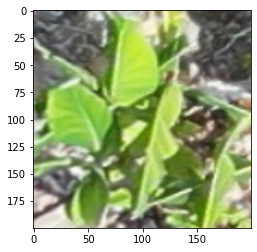

Is it a Musacea? 0


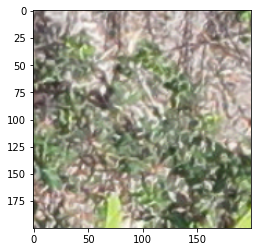

Is it a Musacea? 1


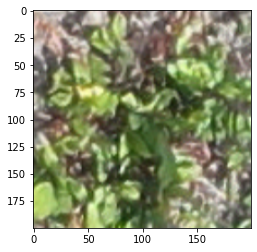

Is it a Musacea? 1


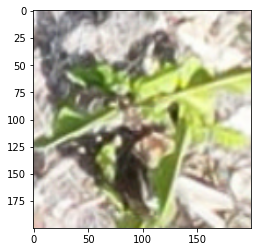

Is it a Musacea? 0


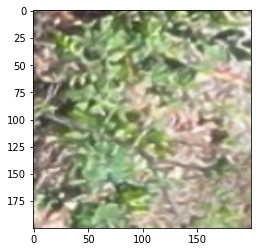

Is it a Musacea? 1


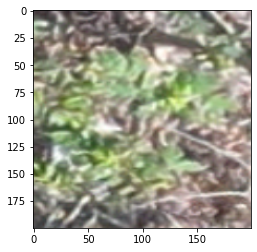

Is it a Musacea? 1


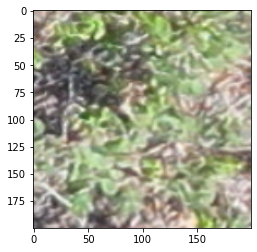

Is it a Musacea? 1


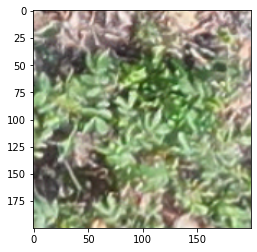

Is it a Musacea? 1


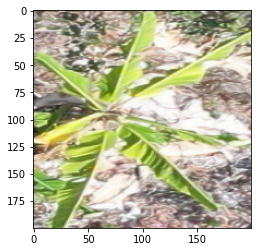

Is it a Musacea? 0


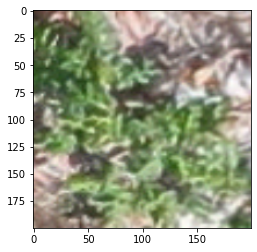

Is it a Musacea? 1


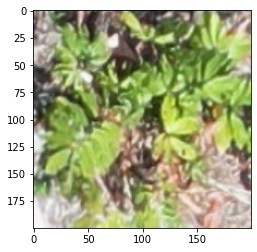

Is it a Musacea? 1


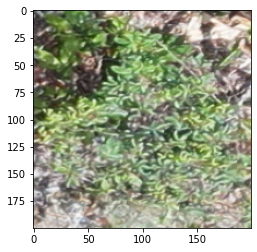

Is it a Musacea? 1


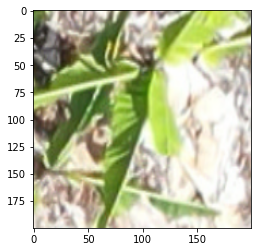

Is it a Musacea? 0


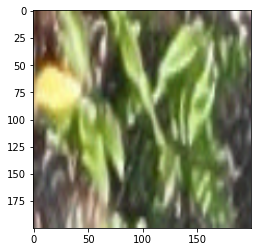

Is it a Musacea? 1


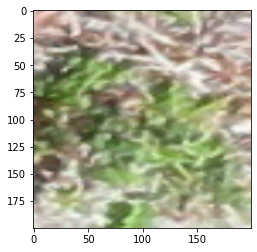

Is it a Musacea? 1


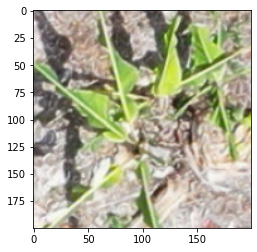

Is it a Musacea? 0


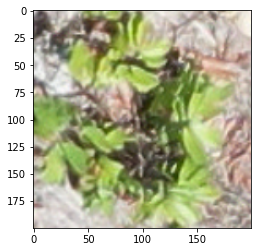

Is it a Musacea? 1


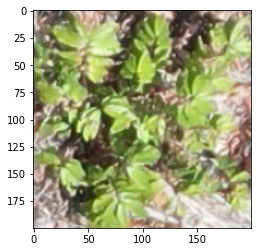

Is it a Musacea? 1


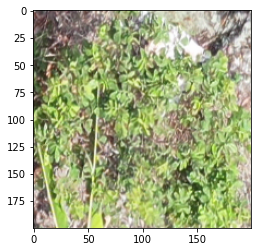

Is it a Musacea? 1


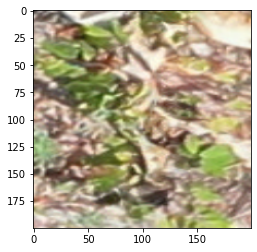

Is it a Musacea? 1


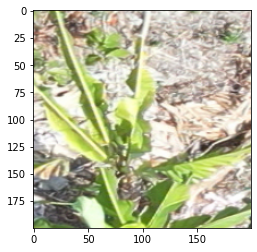

Is it a Musacea? 0


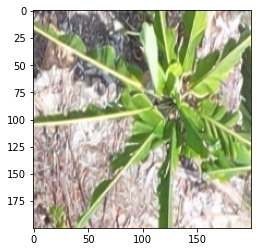

Is it a Musacea? 0


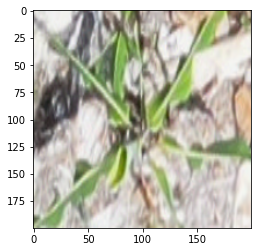

Is it a Musacea? 0


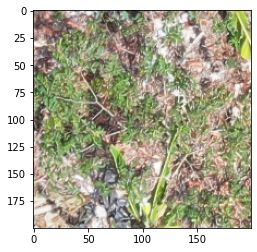

Is it a Musacea? 1


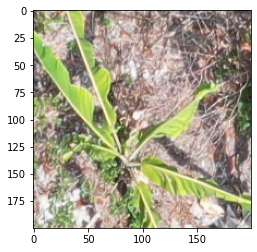

Is it a Musacea? 0


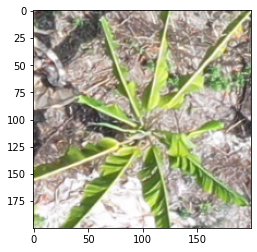

Is it a Musacea? 0


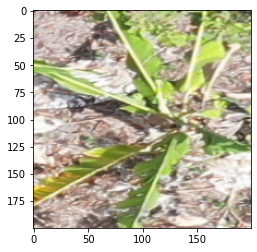

Is it a Musacea? 0


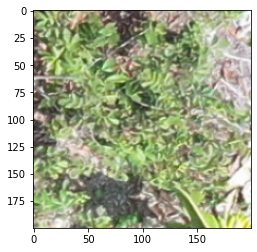

Is it a Musacea? 1


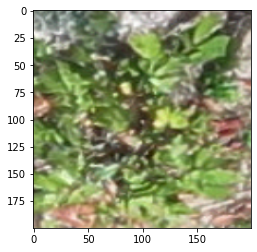

Is it a Musacea? 1


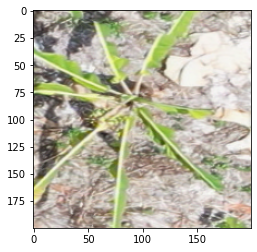

Is it a Musacea? 0


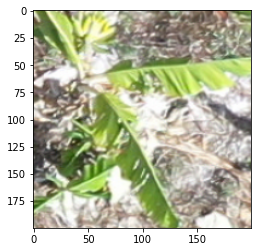

Is it a Musacea? 0


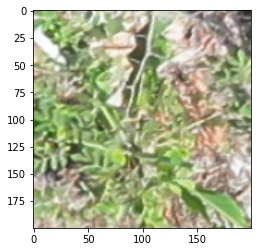

Is it a Musacea? 1


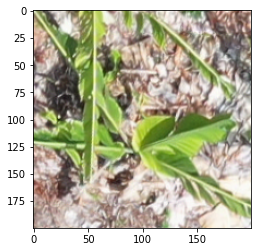

Is it a Musacea? 0


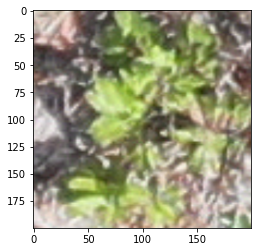

Is it a Musacea? 1


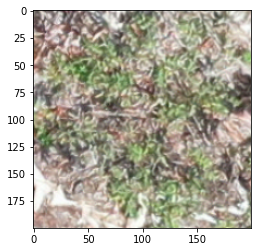

Is it a Musacea? 1


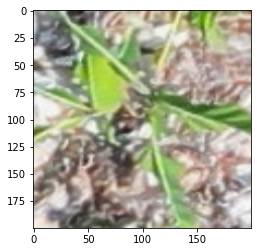

Is it a Musacea? 0


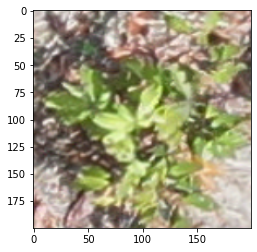

Is it a Musacea? 1


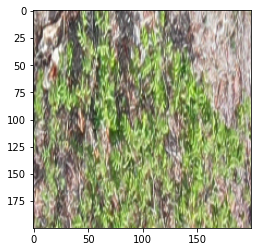

Is it a Musacea? 1


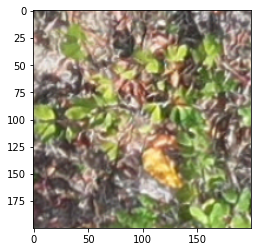

Is it a Musacea? 1


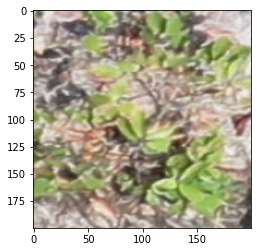

Is it a Musacea? 1


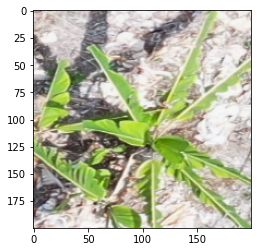

Is it a Musacea? 0


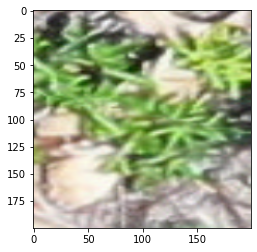

Is it a Musacea? 1


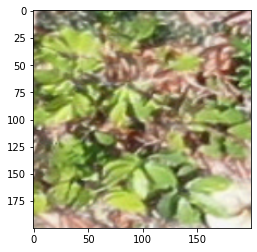

Is it a Musacea? 1


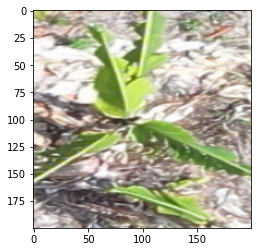

Is it a Musacea? 0


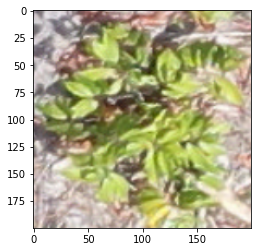

Is it a Musacea? 1


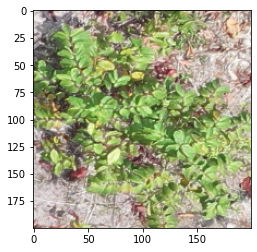

Is it a Musacea? 1


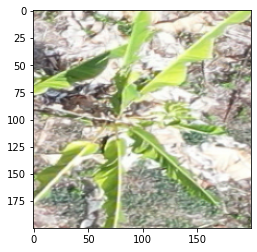

Is it a Musacea? 0


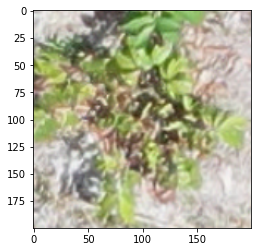

Is it a Musacea? 1


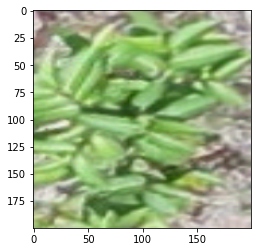

Is it a Musacea? 1


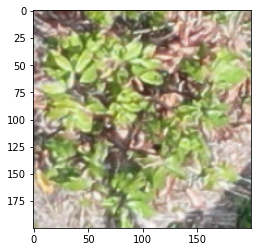

Is it a Musacea? 1


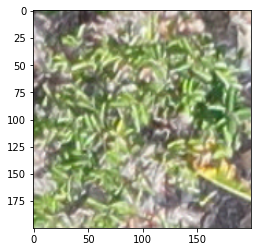

Is it a Musacea? 1


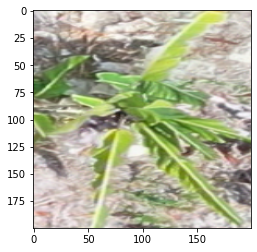

Is it a Musacea? 0


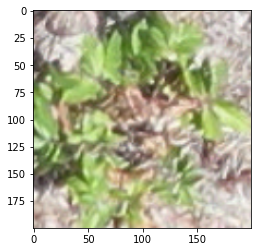

Is it a Musacea? 1


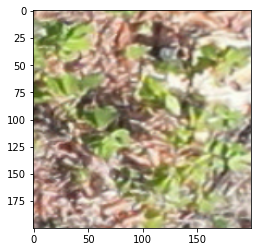

Is it a Musacea? 1


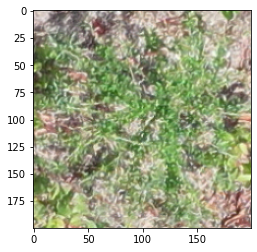

Is it a Musacea? 1


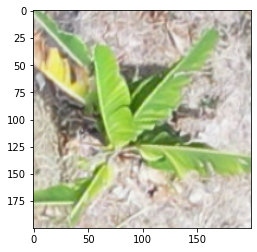

Is it a Musacea? 0


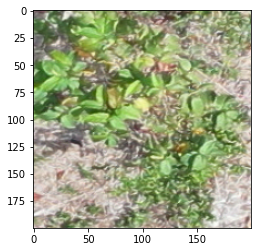

Is it a Musacea? 1


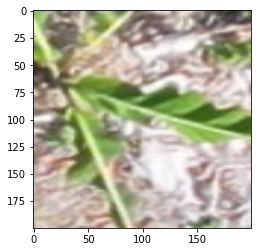

Is it a Musacea? 0


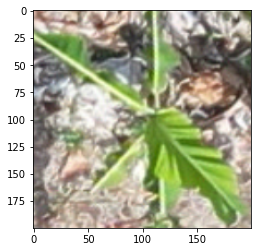

Is it a Musacea? 0


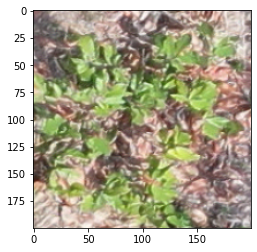

Is it a Musacea? 1


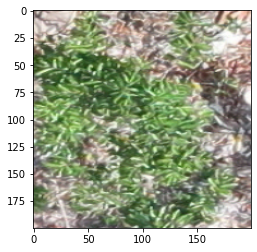

Is it a Musacea? 1


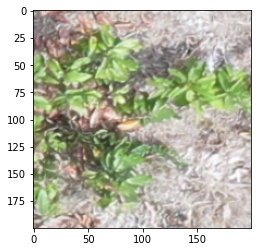

Is it a Musacea? 1


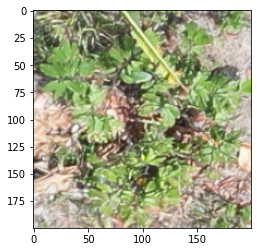

Is it a Musacea? 1


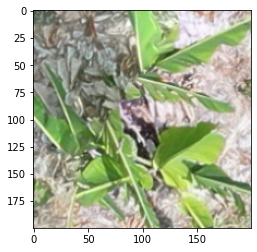

Is it a Musacea? 0


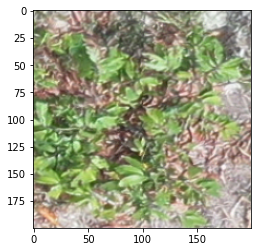

Is it a Musacea? 1


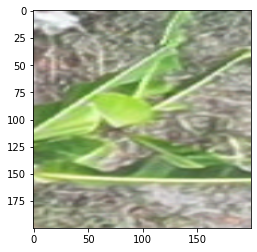

Is it a Musacea? 0


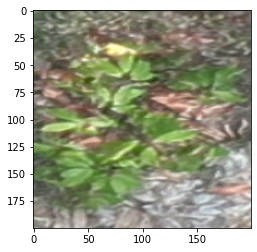

Is it a Musacea? 1


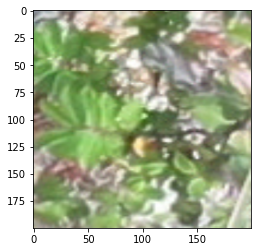

Is it a Musacea? 1


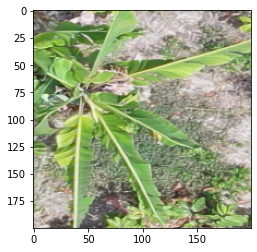

Is it a Musacea? 0


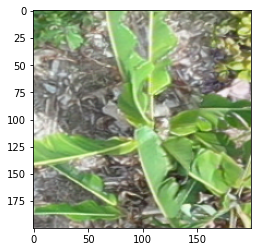

Is it a Musacea? 0


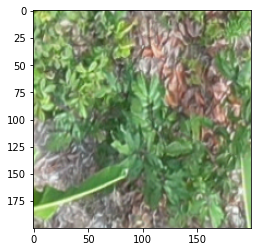

Is it a Musacea? 1


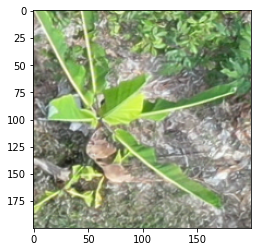

Is it a Musacea? 0


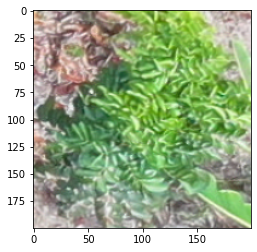

Is it a Musacea? 1


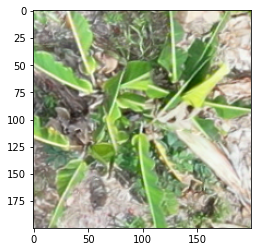

Is it a Musacea? 0


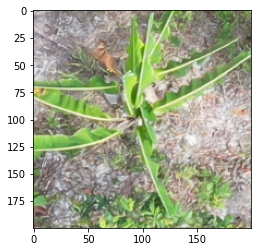

Is it a Musacea? 0


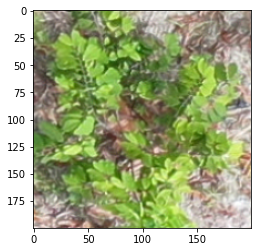

Is it a Musacea? 1


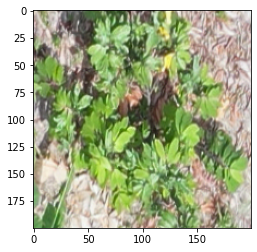

Is it a Musacea? 1


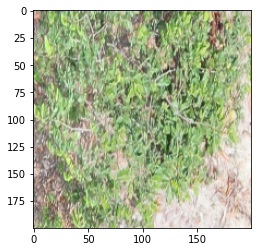

Is it a Musacea? 1


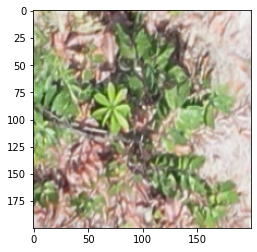

Is it a Musacea? 1


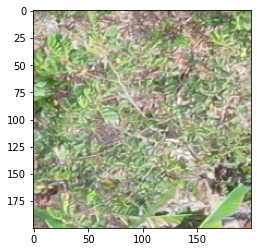

Is it a Musacea? 1


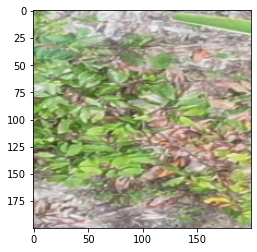

Is it a Musacea? 1


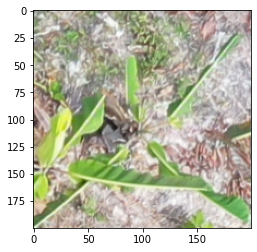

Is it a Musacea? 0


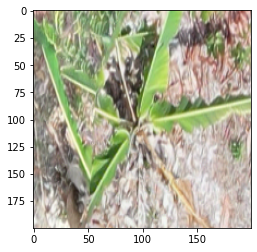

Is it a Musacea? 0


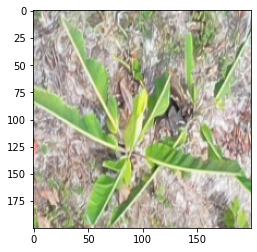

Is it a Musacea? 0


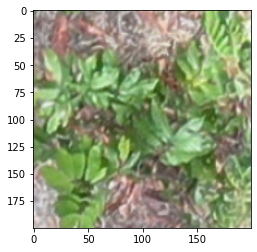

Is it a Musacea? 1


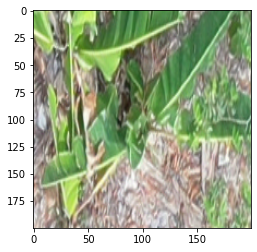

Is it a Musacea? 0


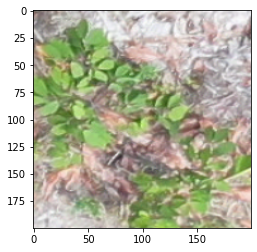

Is it a Musacea? 1


In [121]:
test_dir = 'cnn/test2'
path_to_img_test = os.path.join(os.getcwd(), 'cnn/test2/test_example_2.png')

# Label patches: 0 if musacea; 1 otherwise
X_test, labels_test = get_patches_and_labels('cnn/test2', 'test_example_2', path_to_img_test, boxes_test)  
X_test = X_test/255.

In [156]:
X_test = np.load('cnn/test/patches.npy')
y_true = np.load('cnn/test/labels.npy')
y_true = y_true.astype(int)

In [157]:
classes_1 = model_1.predict(X_test/255)
classes_2 = model_2.predict(X_test/255)

label is:  0
class 1 is:  [0.]
class 2 is:  [1.]
label is:  1
class 1 is:  [0.]
class 2 is:  [1.]
label is:  1
class 1 is:  [0.]
class 2 is:  [1.]
label is:  0
class 1 is:  [0.]
class 2 is:  [1.]
label is:  1
class 1 is:  [0.]
class 2 is:  [1.]
label is:  0
class 1 is:  [0.]
class 2 is:  [1.]
label is:  0
class 1 is:  [0.]
class 2 is:  [1.]
label is:  0
class 1 is:  [0.]
class 2 is:  [1.]
label is:  0
class 1 is:  [0.]
class 2 is:  [1.]
label is:  0
class 1 is:  [0.]
class 2 is:  [1.]
label is:  1
class 1 is:  [0.]
class 2 is:  [1.]
label is:  1
class 1 is:  [0.]
class 2 is:  [1.]
label is:  0
class 1 is:  [0.]
class 2 is:  [1.]
label is:  0
class 1 is:  [0.]
class 2 is:  [1.]
label is:  0
class 1 is:  [0.]
class 2 is:  [1.]
label is:  0
class 1 is:  [0.]
class 2 is:  [1.]
label is:  0
class 1 is:  [0.]
class 2 is:  [1.]
label is:  0
class 1 is:  [0.]
class 2 is:  [1.]
label is:  1
class 1 is:  [0.]
class 2 is:  [1.]
label is:  0
class 1 is:  [0.]
class 2 is:  [1.]
label is:  0
class 1

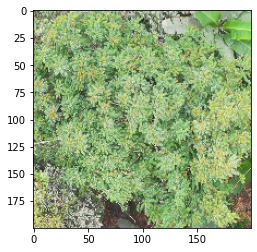

In [100]:
for i in range(len(X_test)):
    plt.imshow(X_test[i])
    print('label is: ', y_true[i])
    print('class 1 is: ', classes_1[i])
    print('class 2 is: ', classes_2[i])

In [158]:
y_pred_1 = classes_1.round()
y_pred_2 = classes_2.round()

print('Accuracy for CNN model trained on 239 Handlabeled patches, tested on 105 Handlabeled patches: ', accuracy_score(y_true, y_pred_1))
print('Accuracy for CNN model trained on 4660 patches after Matching with OT, tested on 105 Handlabeled patches: ', accuracy_score(y_true, y_pred_2))

Accuracy for CNN model trained on 239 Handlabeled patches, tested on 105 Handlabeled patches:  0.8380952380952381
Accuracy for CNN model trained on 4660 patches after Matching with OT, tested on 105 Handlabeled patches:  0.7619047619047619


In [85]:
0.7619047619047619 + 0.23809523809523808

1.0

# NEON

In [154]:
def get_patches_and_labels_neon(final):
    # read image, based on command line filename argument;
    # read the image as grayscale from the outset
    patches = []
    labels = []
    
    if 'img_path_d' in final.columns:
        final = final.rename(columns = {'img_path_d': 'img_path'})

    for index, row in final.iterrows():
        src = rasterio.open(os.path.join('NEON/images', row.img_path))
        raster = src.read()
        image = reshape_as_image(raster)
        tree = image[int(row.ymin):int(row.ymax), int(row.xmin):int(row.xmax)].astype(int)
        patches.append(tree)
        labels.append(row.scientificName)
    return(patches, labels)

def get_height_labels_neon(final):
    labels = []
    
    if 'img_path_d' in final.columns:
        final = final.rename(columns = {'img_path_d': 'img_path'})

    for index, row in final.iterrows():
        labels.append(row.height)
    return(labels)

def get_diameter_labels_neon(final):
    labels = []
    
    if 'img_path_d' in final.columns:
        final = final.rename(columns = {'img_path_d': 'img_path'})

    for index, row in final.iterrows():
        labels.append(row.stemDiameter)
    return(labels)


def get_patches_and_labels_idtree(final):
    # read image, based on command line filename argument;
    # read the image as grayscale from the outset
    patches = []
    labels = []

    for index, row in final.iterrows():
        src = rasterio.open(os.path.join('IDTrees', row.rgb_path))
        raster = src.read()
        image = reshape_as_image(raster)
        if row.site_id == 'ESALQ':
            tree = image[:,:,:3].astype(int)
        else:
            tree = image[int(row.ymin):int(row.ymax), int(row.xmin):int(row.xmax)].astype(int)
        patches.append(tree)
        labels.append(row.scientific_name)
    return(patches, labels)


### Training patches and labels on NEON real (ground and drone data)

In [135]:
final = pd.read_csv('NEON/results/Nearest Neighbours_final_matching.csv', index_col = 0)
patches, labels = get_patches_and_labels_neon(final)
np.save('NEON/cnn/train/patches_nn.npy', patches)
np.save('NEON/cnn/train/labels_nn.npy', labels)

KeyboardInterrupt: 

In [131]:
final = pd.read_csv('NEON/results/Optimal Transport Non-Greedy_final_matching.csv', index_col = 0)
patches, labels = get_patches_and_labels_neon(final)
np.save('NEON/cnn/train/patches_ot_non_greedy.npy', patches)
np.save('NEON/cnn/train/labels_ot_non_greedy.npy', labels)

In [132]:
final = pd.read_csv('NEON/results/Optimal Transport Greedy_final_matching.csv', index_col = 0)
patches, labels = get_patches_and_labels_neon(final)
np.save('NEON/cnn/train/patches_ot_greedy.npy', patches)
np.save('NEON/cnn/train/labels_ot_greedy.npy', labels)

In [133]:
final = pd.read_csv('NEON/results/Graph Matching Network_final_matching.csv', index_col = 0)
patches, labels = get_patches_and_labels_neon(final)
np.save('NEON/cnn/train/patches_gmn.npy', patches)
np.save('NEON/cnn/train/labels_gmn.npy', labels)

In [134]:
final = pd.read_csv('NEON/results/Gromov-Wasserstein Greedy_final_matching.csv', index_col = 0)
patches, labels = get_patches_and_labels_neon(final)
np.save('NEON/cnn/train/patches_gw.npy', patches)
np.save('NEON/cnn/train/labels_gw.npy', labels)

### Training patches and labels on NEON synthetic (noise added)

In [191]:
dir = 'NEON/results'
for file in os.listdir(dir):
    if file.startswith('final'):
        sigma = file.split('_')[3]
        method = file.split('_')[1]
        path_file = os.path.join(dir, file)
        final = pd.read_csv(path_file, index_col = 0)
        print(final.shape)
        print(file)
        patches, labels = get_patches_and_labels_neon(final)
        np.save('NEON/cnn/train/patches_{}_sigma_{}.npy'.format(method, sigma), patches)
        np.save('NEON/cnn/train/labels_{}_sigma_{}.npy'.format(method, sigma), labels)

(3839, 24)
final_OT non greedy_sigma_1.5.csv
(3839, 24)
final_NN_sigma_1.0.csv
(3839, 24)
final_NN_sigma_3.0.csv
(3839, 24)
final_OT non greedy_sigma_3.5.csv
(3839, 24)
final_NN_sigma_3.5.csv
(3839, 24)
final_OT non greedy_sigma_3.0.csv
(3839, 24)
final_OT non greedy_sigma_1.0.csv
(3839, 24)
final_NN_sigma_1.5.csv
(3839, 24)
final_NN_sigma_2.0.csv
(3839, 24)
final_OT non greedy_sigma_2.5.csv
(3839, 24)
final_OT non greedy_sigma_0.5.csv
(3839, 24)
final_OT non greedy_sigma_4.0.csv
(3839, 24)
final_NN_sigma_0.0.csv
(3839, 24)
final_OT non greedy_sigma_0.0.csv
(3839, 24)
final_NN_sigma_4.0.csv
(3839, 24)
final_NN_sigma_0.5.csv
(3839, 24)
final_NN_sigma_2.5.csv
(3839, 24)
final_OT non greedy_sigma_2.0.csv
(3839, 24)
final_OT greedy_sigma_2.5.csv
(3839, 23)
final_GMN_sigma_0.5.csv
(3839, 24)
final_GW_sigma_1.0.csv
(3839, 23)
final_GMN_sigma_4.0.csv
(3839, 24)
final_OT greedy_sigma_4.0.csv
(3839, 24)
final_GW_sigma_3.0.csv
(3839, 23)
final_GMN_sigma_2.5.csv
(3839, 24)
final_OT greedy_sigma_0

In [161]:
dir = 'NEON/cnn/train'
path_patches = os.path.join(dir, 'patches_NN_sigma_0.0.npy')
path_labels = os.path.join(dir, 'labels_NN_sigma_0.0.npy')
patches0 = np.load(path_patches, allow_pickle=True)
labels0 = np.load(path_labels, allow_pickle=True)

path_patches = os.path.join(dir, 'patches_OT non greedy_sigma_1.0.npy')
path_labels = os.path.join(dir, 'labels_OT non greedy_sigma_1.0.npy')
patches1 = np.load(path_patches, allow_pickle=True)
labels1 = np.load(path_labels, allow_pickle=True)

3839 3839
1


In [189]:
final_nn = pd.read_csv('NEON/results/final_GW_sigma_0.0.csv', index_col = 0)
a = final_nn['ground_index'].to_numpy()

final_ot_non_greedy = pd.read_csv('NEON/results/final_OT non greedy_sigma_2.0.csv', index_col = 0)
b = final_ot_non_greedy['ground_index'].to_numpy()

print(len(np.where(a != b)[0]))
a[np.where(a != b)[0]], b[np.where(a != b)[0]]

3614


(array([  0,   1,   2, ..., 193, 194, 195]),
 array([  3,   3,   3, ..., 176, 176, 192]))

In [148]:
dir = 'NEON/results'
for file in os.listdir(dir):
    if file.startswith('final'):
        sigma = file.split('_')[3]
        method = file.split('_')[1]
        path_file = os.path.join(dir, file)
        final = pd.read_csv(path_file, index_col = 0)
        
        heights = get_height_labels_neon(final)
        np.save('NEON/cnn/train/heights_{}_sigma_{}.npy'.format(method, sigma), heights)

In [155]:
dir = 'NEON/results'
for file in os.listdir(dir):
    if file.startswith('final'):
        sigma = file.split('_')[3]
        method = file.split('_')[1]
        path_file = os.path.join(dir, file)
        final = pd.read_csv(path_file, index_col = 0)
        
        diameters = get_diameter_labels_neon(final)
        np.save('NEON/cnn/train/diameters_{}_sigma_{}.npy'.format(method, sigma), diameters)


In [149]:
# Testing Set correponds to the true matching
true_matching = pd.read_csv('NEON/data/true_matching.csv', index_col = 0)
            
new_df = true_matching.copy()
n = len(new_df)
N = int(n*0.2)
Test = []
for i in range(5):
    test = new_df.sample(n=N, random_state=1)
    Test.append(test)
    new_df = new_df.drop(test.index) 

In [141]:
for i in range(len(Test)):
    patches, labels = get_patches_and_labels_neon(Test[i])
    np.save('NEON/cnn/test/patches_test_{}.npy'.format(i+1), patches)
    np.save('NEON/cnn/test/labels_test_{}.npy'.format(i+1), labels)

In [150]:
for i in range(len(Test)):
    heights = get_height_labels_neon(Test[i])
    np.save('NEON/cnn/test/heights_test_{}.npy'.format(i+1), heights)

In [156]:
for i in range(len(Test)):
    diameters = get_diameter_labels_neon(Test[i])
    np.save('NEON/cnn/test/diameters_test_{}.npy'.format(i+1), diameters)

In [153]:
a = true_matching['height'].to_numpy()
b = true_matching['stemDiameter'].to_numpy()

a = a[~np.isnan(a)]
b = b[~np.isnan(b)]

print(len(a), len(b))


2131 3545


## Models

### BASIC 1

In [ ]:
IMG_SIZE = 200


model = Sequential()

model.add(Conv2D(32, kernel_size=6, activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, 3)))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization(momentum=0.01))

model.add(Conv2D(32, kernel_size=3, activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization(momentum=0.01))

model.add(Conv2D(64, kernel_size=3, activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization(momentum=0.01))

model.add(Conv2D(64, kernel_size=3, activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization(momentum=0.01))

model.add(Conv2D(128, kernel_size=3, activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization(momentum=0.01))

model.add(Conv2D(128, kernel_size=3, activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization(momentum=0.01))

model.add(Conv2D(256, kernel_size=3, activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization(momentum=0.01))

model.add(Conv2D(256, kernel_size=3, activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization(momentum=0.01))

model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(1, activation='sigmoid'))

### BASIC 2

In [ ]:
# build a sequential model
model = Sequential()
model.add(InputLayer(input_shape=(200, 200, 3)))

# 1st conv block
model.add(Conv2D(25, (5, 5), activation='relu', strides=(1, 1), padding='same'))
model.add(MaxPool2D(pool_size=(2, 2), padding='same'))
# 2nd conv block
model.add(Conv2D(50, (5, 5), activation='relu', strides=(2, 2), padding='same'))
model.add(MaxPool2D(pool_size=(2, 2), padding='same'))
model.add(BatchNormalization())
# 3rd conv block
model.add(Conv2D(70, (3, 3), activation='relu', strides=(2, 2), padding='same'))
model.add(MaxPool2D(pool_size=(2, 2), padding='valid'))
model.add(BatchNormalization())
# ANN block
model.add(Flatten())
model.add(Dense(units=100, activation='relu'))
model.add(Dense(units=100, activation='relu'))
model.add(Dropout(0.25))
# output layer
model.add(Dense(units=1, activation='sigmoid'))


# compile model
#opt = tf.keras.optimizers.SGD(lr=0.01)
#opt = tf.keras.optimizers.Adam(learning_rate=0.1)
#opt = tf.keras.optimizers.RMSprop(lr=0.01)

model.compile(optimizer='rmsprop', loss = 'binary_crossentropy', metrics = ['accuracy'])




### RESNET

In [94]:
restnet = ResNet50(include_top=False, weights=None, input_shape=(200,200,3))
output = restnet.layers[-1].output
output = keras.layers.Flatten()(output)
restnet = Model(restnet.input, output=output)
for layer in restnet.layers:
    layer.trainable = True
restnet.summary()

model_resnet = Sequential()
model_resnet.add(restnet)
model_resnet.add(Dense(512, activation='relu', input_dim=(200,200,3)))
model_resnet.add(Dropout(0.3))
model_resnet.add(Dense(512, activation='relu'))
model_resnet.add(Dropout(0.3))
model_resnet.add(Dense(1, activation='sigmoid'))
model_resnet.compile(loss='binary_crossentropy',
              optimizer=optimizers.RMSprop(lr=2e-5),
              metrics=['accuracy'])
model_resnet.summary()



/anaconda3/envs/venv/lib/python3.6/site-packages/keras_applications/resnet50.py:265: UserWarning: The output shape of `ResNet50(include_top=False)` has been changed since Keras 2.2.0.
  warnings.warn('The output shape of `ResNet50(include_top=False)` '
/anaconda3/envs/venv/lib/python3.6/site-packages/ipykernel_launcher.py:4: UserWarning: Update your `Model` call to the Keras 2 API: `Model(Tensor("in..., outputs=Tensor("fl...)`
  after removing the cwd from sys.path.


Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_12 (InputLayer)           (None, 200, 200, 3)  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 206, 206, 3)  0           input_12[0][0]                   
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 100, 100, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, 100, 100, 64) 256         conv1[0][0]                      
____________________________________________________________________________________________

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
model_2 (Model)              (None, 100352)            23587712  
_________________________________________________________________
dense_14 (Dense)             (None, 512)               51380736  
_________________________________________________________________
dropout_5 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_15 (Dense)             (None, 512)               262656    
_________________________________________________________________
dropout_6 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_16 (Dense)             (None, 1)                 513       
Total params: 75,231,617
Trainable params: 75,178,497
Non-trainable params: 53,120
_____________________________________

### MOBILENET

In [ ]:
base_model = tf.keras.applications.MobileNetV2(include_top = False, weights=None, input_shape=(200, 200, 3))
x = base_model.output
x = tf.keras.layers.GlobalAveragePooling2D()(x)
preds =  tf.keras.layers.Dense(1, activation = tf.nn.sigmoid)(x)

model=tf.keras.Model(inputs=base_model.input,outputs=preds)


opt = tf.keras.optimizers.SGD(lr=0.01)
#opt = tf.keras.optimizers.Adam(learning_rate=0.1)
#opt = tf.keras.optimizers.RMSprop(lr=0.01)

model.compile(optimizer=opt, loss = 'binary_crossentropy', metrics = ['accuracy'])

## NEON BASIC

In [5]:
IMG_SIZE = 224

model = Sequential()
model.add(Conv2D(64, kernel_size=6, activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, 3)))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization(momentum=0.01))

model.add(Conv2D(64, kernel_size=3, activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization(momentum=0.01))

model.add(Conv2D(32, kernel_size=3, activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization(momentum=0.01))

model.add(Conv2D(32, kernel_size=3, activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization(momentum=0.01))

model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(63, activation='softmax'))

In [6]:
!pip install netron

     |████████████████████████████████| 1.4 MB 10.6 MB/s eta 0:00:01


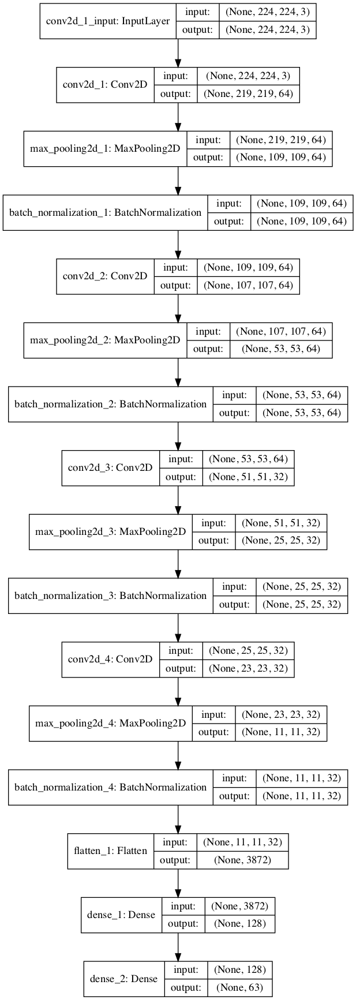

In [9]:
tf.keras.utils.plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True)